In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pyplot as plt
import rcca_modified as rcca
#reload(rcca)
from unils_cca import set_diag_to_zero
from metrics import ClassificationResult
from unils_cca import binarize, set_diag_to_zero, BuildMatrixA, printMatrix, print_q_val_hist, zscore, plot_zscore, BuildFeatureVector,\
train_test_2D, build_distance_for_node,  get_features, build_distance_matrix, remove_ambiguous, \
get_pairs_distance_matched,  reshape_2d_to_1d, demean, get_pos_neg_y_and_ypred_at_thres, binarize_wAmbig, subsample_neg
import copy
from sklearn.metrics import auc, precision_recall_curve, roc_auc_score

In [2]:
InteractionsFileCaptureC='/srv/scratch/mtaranov/CaptureC_ChicagoCalls/CaptureC_SC_bait-bait.bed.gz'
#InteractionsFileCaptureC='/mnt/lab_data/kundaje/mtaranov/ChicagoCalls/D0_D2D8_merge_BaitToBait_intra.bed.gz'
PromoterFile='/srv/scratch/mtaranov/HindIII/PromoterCapture_Digest_Human_HindIII_baits_ID.bed'
DATADIR='/users/mtaranov/CCA_model/data/'
DATADIR_CaptureC = DATADIR+'CaptureC/'
DATADIR_kernels = DATADIR+'CaptureC_kernels/'
DATADIR_nodes = DATADIR+'nodes/'
DATADIR_features = DATADIR+'features/'
DATADIR_preds = DATADIR+'preds_2d/'
DATADIR_weights = DATADIR+'weights/'
DATADIR_dist_matched_labels = DATADIR+'labels/labels_kernel_dist_matched/'
DATADIR_dist_matched_preds = DATADIR+'labels/preds_kernel_dist_matched/'

In [15]:
def performance_on_pos_and_neg_subsmpl(thres):
    all_chrs = ['chr'+str(i+1) for i in range(22)]+['chrX']
    ROC=[]
    PRC=[]
    for chr in all_chrs:
        print chr
        preds = np.load(DATADIR_preds+'pred_2d_'+chr+'.npy')
        labels = np.load(DATADIR_kernels+'kernel_CaptureC_'+chr+'.npy')
        y = set_diag_to_zero(binarize(labels, thres).reshape((labels.shape[0]*labels.shape[0],1)).astype(int))  
        y_pred = preds.reshape((preds.shape[0]*preds.shape[0],1))
        y_neg_sub,y_pred_neg_sub = subsample_neg(y, y_pred, 1, thres=0)
        print(ClassificationResult(y_neg_sub,y_pred_neg_sub))
        print chr
        printMatrix(preds, 'score', 1, 1, str(chr)+' - Prediction')
        printMatrix(binarize(labels, thres=thres), 'score', 1, 1, str(chr)+' LABELS')
        CaptureC = np.load(DATADIR_CaptureC+'CaptureC_'+chr+'.npy')
        printMatrix(binarize(CaptureC, thres=5), 'score', 1, 1, str(chr)+' true CaptureC')
        kernel_CaptureC=np.load(DATADIR_kernels+'kernel_CaptureC_'+chr+'.npy')
        plot_zscore(kernel_CaptureC, 'kernel - CaptureC', chr)
        ROC.append(roc_auc_score(y_neg_sub,y_pred_neg_sub))
        precision, recall = precision_recall_curve(y_neg_sub,y_pred_neg_sub)[:2]
        PRC.append(auc(recall, precision))

    for i in enumerate(all_chrs):
        print i[1], "ROC=", ROC[i[0]], "PRC=", PRC[i[0]]
    print "Average across all chrs: ROC=", sum(ROC)/len(ROC), " PRC=", sum(PRC)/len(PRC)

## Performance for all nodes in held out chr 
weights are averagded across all chrs except the held out one

### Evaluation on positives+subsapmled negatives

chr1
Balanced Accuracy: 65.36%	auROC: 0.749	 auPRC: 0.742
Recall at 5% | 10% | 25% FDR: 9.3% | 17.3% | 40.5%	Num Positives: 1120	 Num Negatives: 1120

chr1
0.999999999901
(2272, 2272)
Limit: 0.999999999901


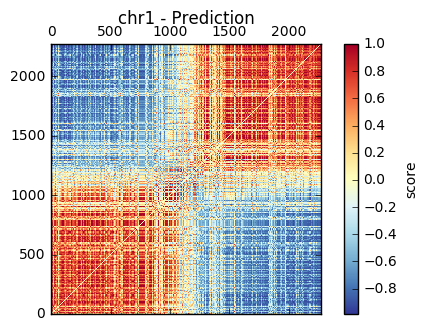

1.0
(2272, 2272)
Limit: 1.0


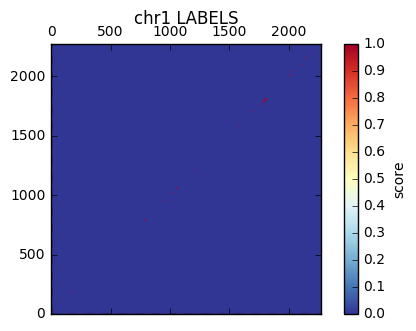

1.0
(2272, 2272)
Limit: 1.0


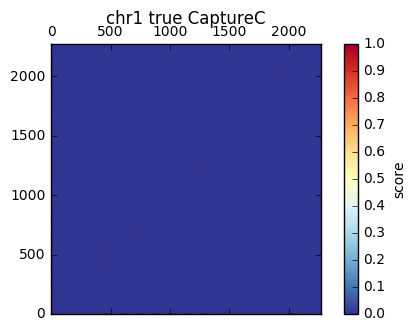

47.6550102298
(2272, 2272)
Limit: 47.6550102298


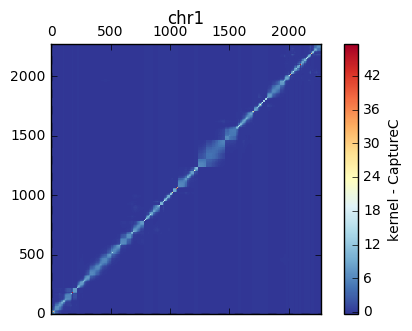

chr2
Balanced Accuracy: 61.19%	auROC: 0.709	 auPRC: 0.692
Recall at 5% | 10% | 25% FDR: 8.6% | 9.3% | 18.7%	Num Positives: 3120	 Num Negatives: 3120

chr2
0.999999999963
(1604, 1604)
Limit: 0.999999999963


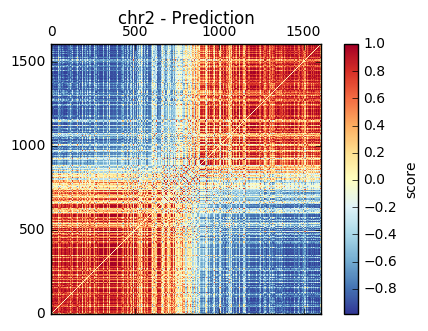

1.0
(1604, 1604)
Limit: 1.0


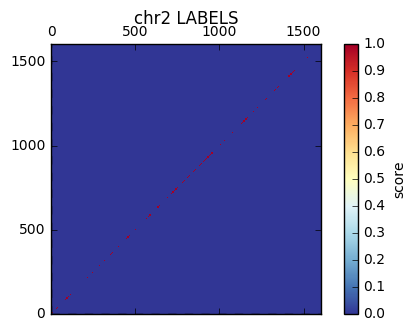

1.0
(1604, 1604)
Limit: 1.0


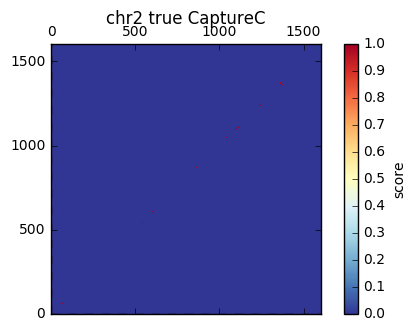

40.0374824383
(1604, 1604)
Limit: 40.0374824383


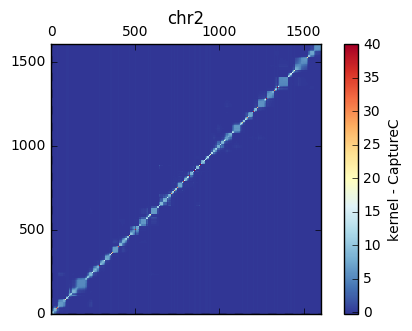

chr3
Balanced Accuracy: 62.90%	auROC: 0.720	 auPRC: 0.706
Recall at 5% | 10% | 25% FDR: 8.8% | 10.0% | 21.2%	Num Positives: 2039	 Num Negatives: 2039

chr3
0.99999999985
(1331, 1331)
Limit: 0.99999999985


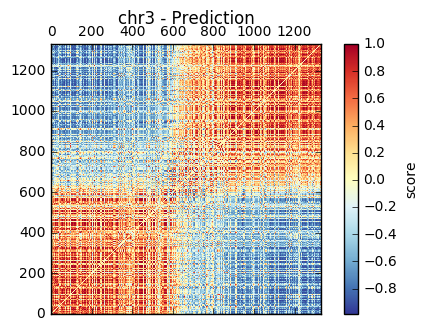

1.0
(1331, 1331)
Limit: 1.0


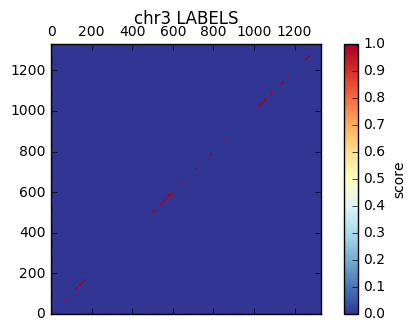

1.0
(1331, 1331)
Limit: 1.0


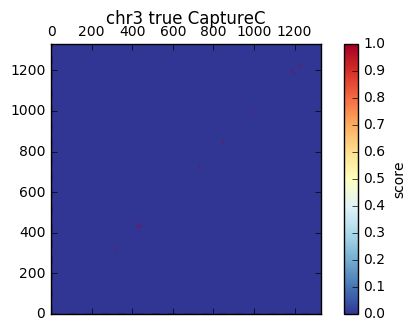

36.4691650576
(1331, 1331)
Limit: 36.4691650576


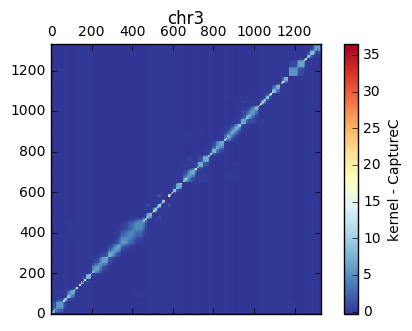

chr4
Balanced Accuracy: 60.79%	auROC: 0.699	 auPRC: 0.678
Recall at 5% | 10% | 25% FDR: 3.1% | 7.1% | 16.2%	Num Positives: 1984	 Num Negatives: 1984

chr4
0.99999999998
(947, 947)
Limit: 0.99999999998


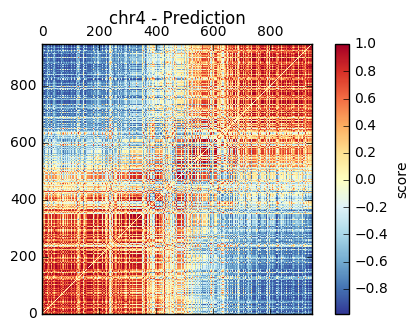

1.0
(947, 947)
Limit: 1.0


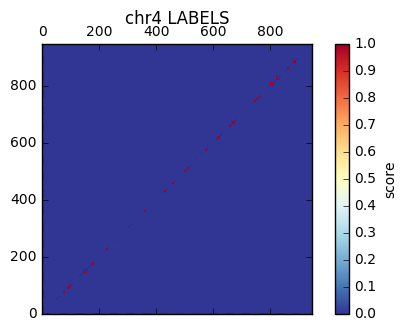

1.0
(947, 947)
Limit: 1.0


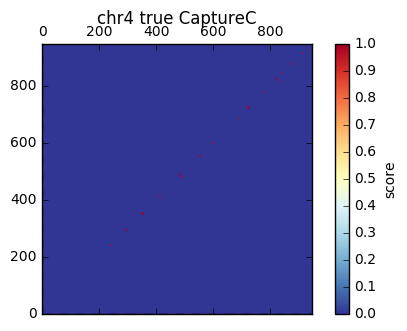

30.7571129985
(947, 947)
Limit: 30.7571129985


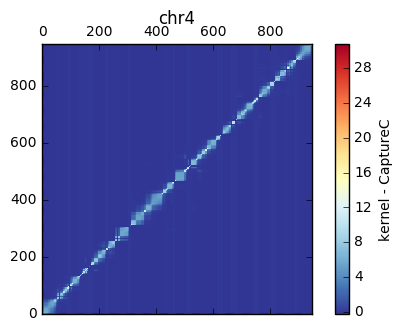

chr5
Balanced Accuracy: 61.41%	auROC: 0.688	 auPRC: 0.694
Recall at 5% | 10% | 25% FDR: 9.7% | 10.1% | 27.6%	Num Positives: 1542	 Num Negatives: 1542

chr5
0.999999998942
(1117, 1117)
Limit: 0.999999998942


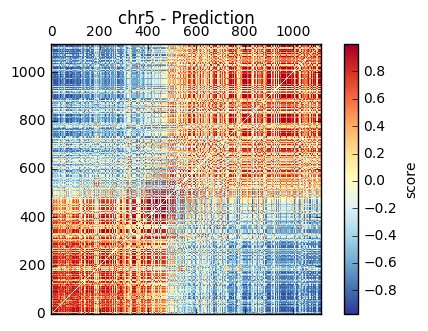

1.0
(1117, 1117)
Limit: 1.0


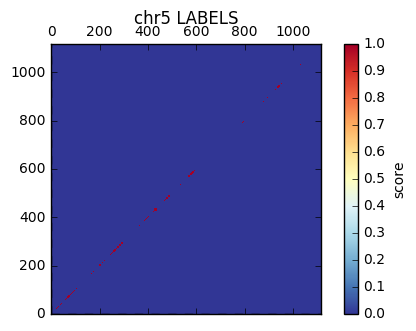

1.0
(1117, 1117)
Limit: 1.0


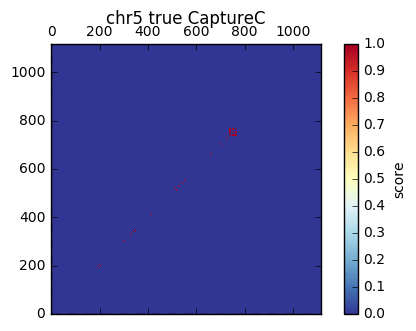

33.406586177
(1117, 1117)
Limit: 33.406586177


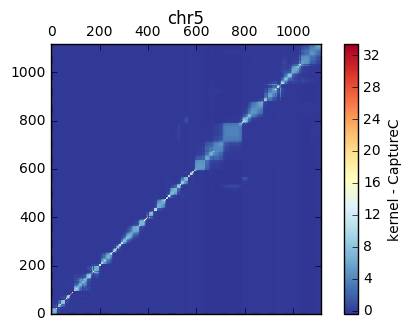

chr6
Balanced Accuracy: 61.16%	auROC: 0.682	 auPRC: 0.673
Recall at 5% | 10% | 25% FDR: 5.4% | 7.3% | 22.8%	Num Positives: 2535	 Num Negatives: 2535

chr6
0.999999999971
(1224, 1224)
Limit: 0.999999999971


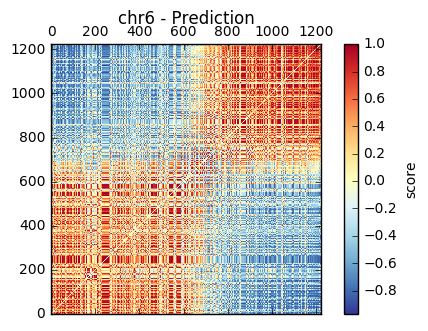

1.0
(1224, 1224)
Limit: 1.0


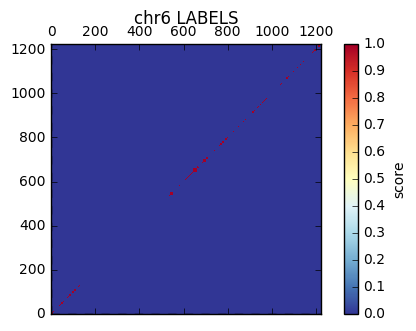

1.0
(1224, 1224)
Limit: 1.0


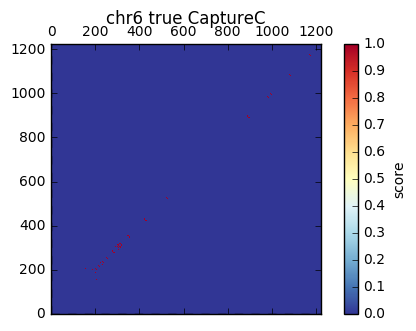

34.9714169001
(1224, 1224)
Limit: 34.9714169001


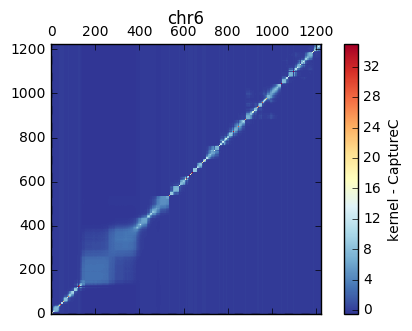

chr7
Balanced Accuracy: 60.33%	auROC: 0.697	 auPRC: 0.694
Recall at 5% | 10% | 25% FDR: 9.7% | 10.8% | 24.4%	Num Positives: 2454	 Num Negatives: 2454

chr7
0.999999999772
(1020, 1020)
Limit: 0.999999999772


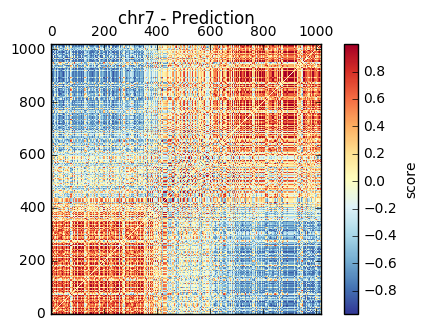

1.0
(1020, 1020)
Limit: 1.0


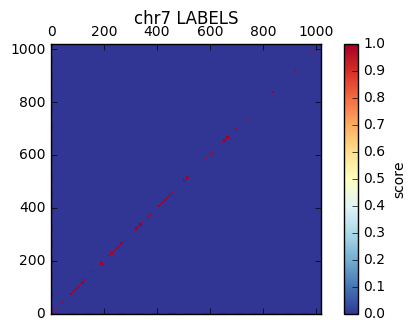

1.0
(1020, 1020)
Limit: 1.0


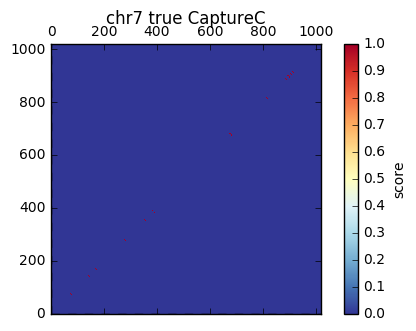

31.921779399
(1020, 1020)
Limit: 31.921779399


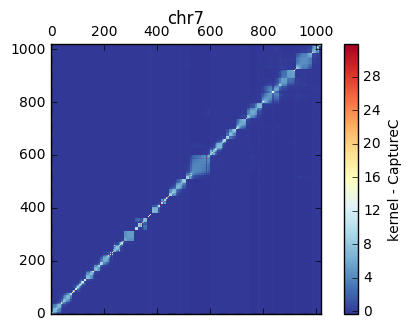

chr8
Balanced Accuracy: 60.22%	auROC: 0.702	 auPRC: 0.684
Recall at 5% | 10% | 25% FDR: 7.3% | 8.3% | 20.9%	Num Positives: 2320	 Num Negatives: 2320

chr8
0.999999999858
(897, 897)
Limit: 0.999999999858


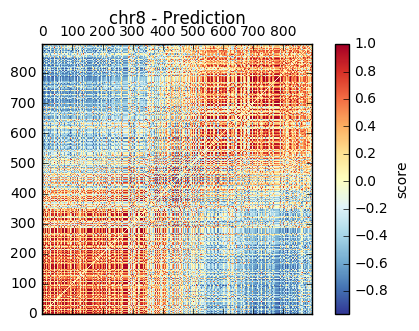

1.0
(897, 897)
Limit: 1.0


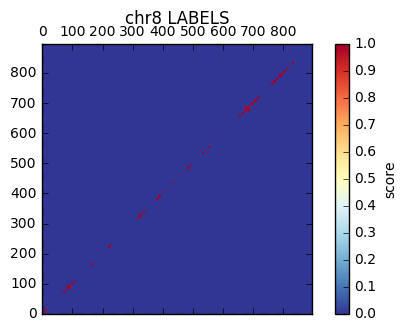

1.0
(897, 897)
Limit: 1.0


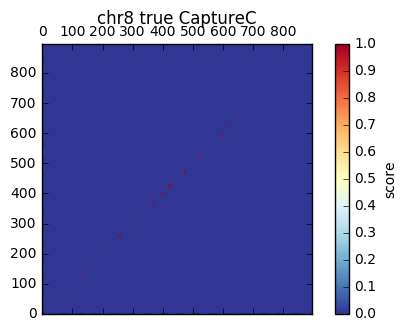

29.9332590942
(897, 897)
Limit: 29.9332590942


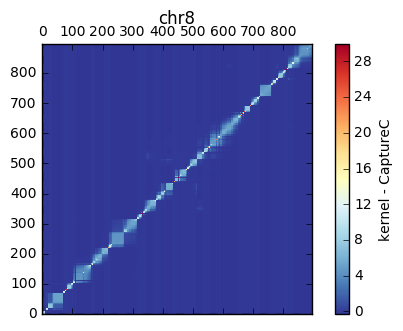

chr9
Balanced Accuracy: 59.39%	auROC: 0.654	 auPRC: 0.665
Recall at 5% | 10% | 25% FDR: 5.8% | 6.2% | 24.5%	Num Positives: 2071	 Num Negatives: 2071

chr9
0.999999998112
(859, 859)
Limit: 0.999999998112


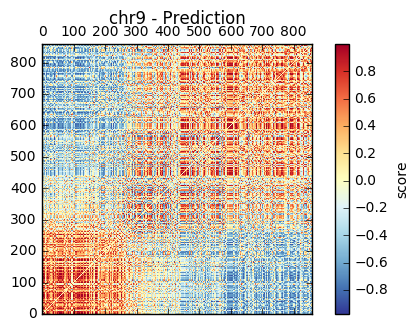

1.0
(859, 859)
Limit: 1.0


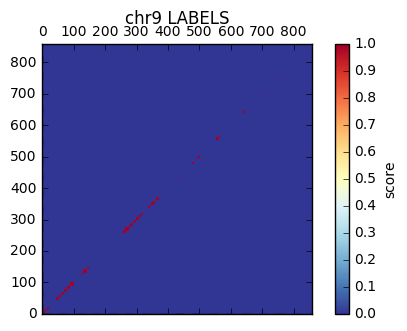

1.0
(859, 859)
Limit: 1.0


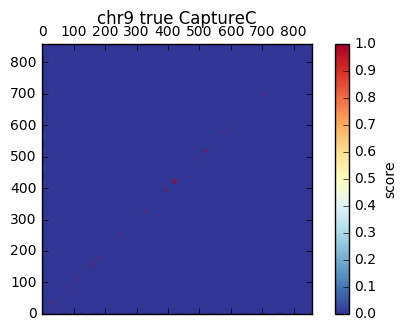

29.2916370318
(859, 859)
Limit: 29.2916370318


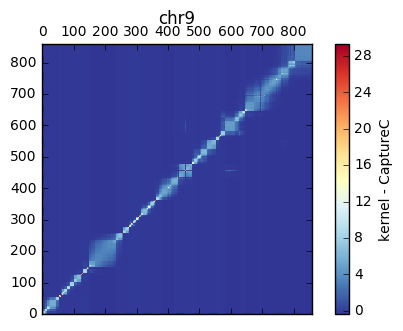

chr10
Balanced Accuracy: 58.38%	auROC: 0.663	 auPRC: 0.671
Recall at 5% | 10% | 25% FDR: 7.7% | 11.4% | 18.9%	Num Positives: 1695	 Num Negatives: 1695

chr10
0.999999999951
(943, 943)
Limit: 0.999999999951


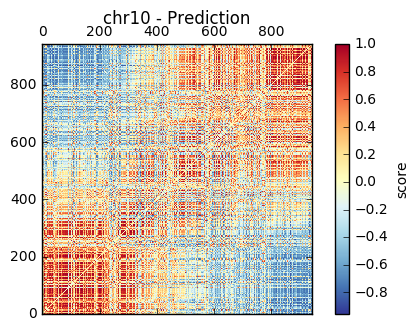

1.0
(943, 943)
Limit: 1.0


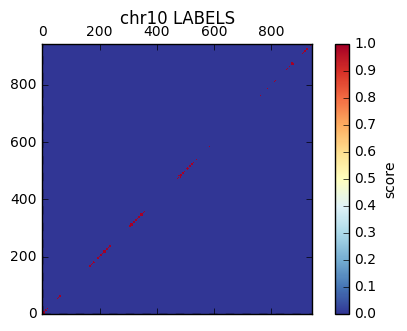

1.0
(943, 943)
Limit: 1.0


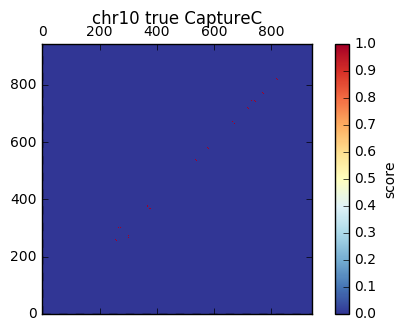

30.6920185064
(943, 943)
Limit: 30.6920185064


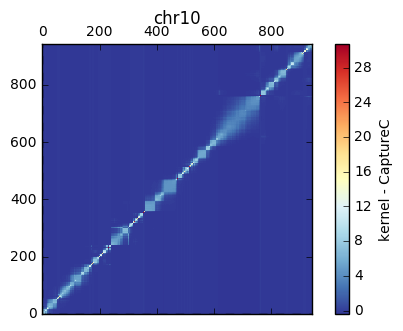

chr11
Balanced Accuracy: 60.82%	auROC: 0.690	 auPRC: 0.669
Recall at 5% | 10% | 25% FDR: 3.9% | 5.3% | 17.3%	Num Positives: 1123	 Num Negatives: 1123

chr11
0.999999999706
(1401, 1401)
Limit: 0.999999999706


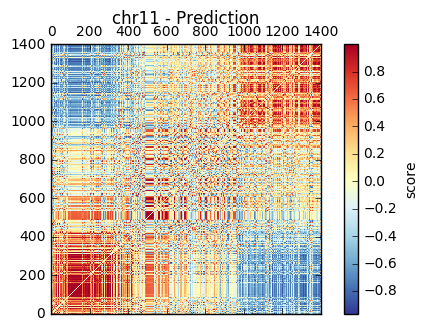

1.0
(1401, 1401)
Limit: 1.0


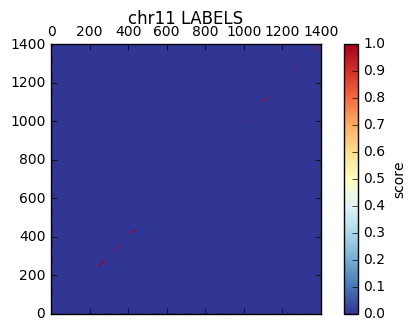

1.0
(1401, 1401)
Limit: 1.0


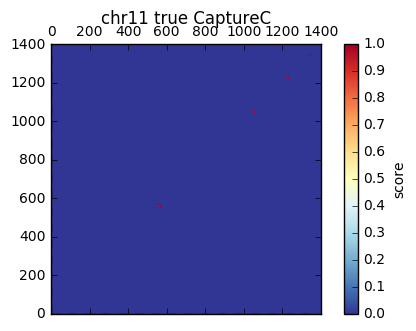

37.4165738677
(1401, 1401)
Limit: 37.4165738677


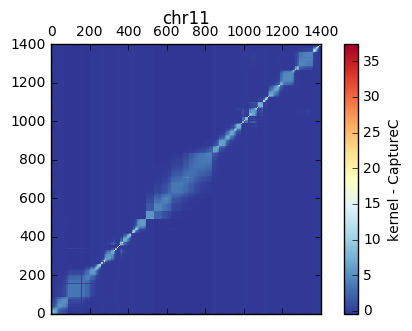

chr12
Balanced Accuracy: 59.53%	auROC: 0.670	 auPRC: 0.675
Recall at 5% | 10% | 25% FDR: 7.7% | 8.9% | 26.4%	Num Positives: 1668	 Num Negatives: 1668

chr12
0.999999999986
(1200, 1200)
Limit: 0.999999999986


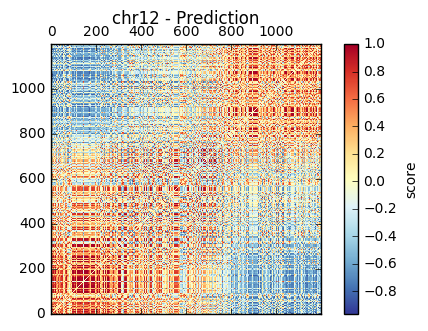

1.0
(1200, 1200)
Limit: 1.0


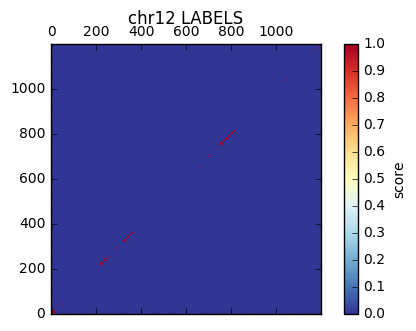

1.0
(1200, 1200)
Limit: 1.0


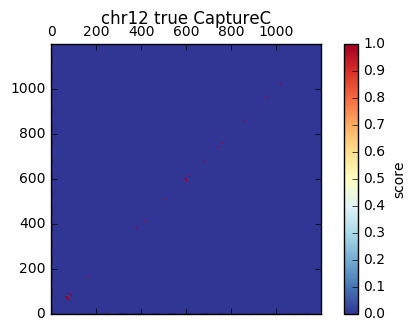

34.6265793864
(1200, 1200)
Limit: 34.6265793864


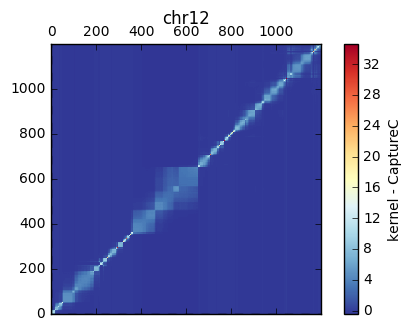

chr13
Balanced Accuracy: 57.18%	auROC: 0.632	 auPRC: 0.658
Recall at 5% | 10% | 25% FDR: 10.7% | 11.3% | 25.7%	Num Positives: 1364	 Num Negatives: 1364

chr13
0.999999976902
(452, 452)
Limit: 0.999999976902


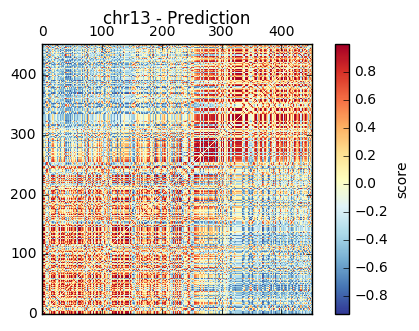

1.0
(452, 452)
Limit: 1.0


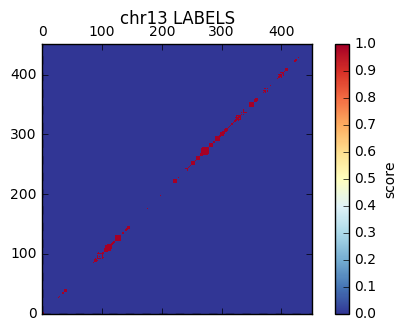

1.0
(452, 452)
Limit: 1.0


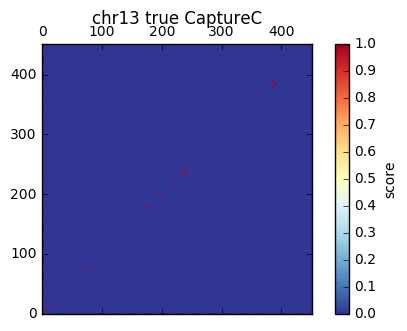

21.2367605816
(452, 452)
Limit: 21.2367605816


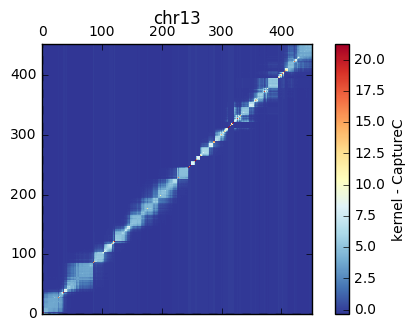

chr14
Balanced Accuracy: 55.99%	auROC: 0.633	 auPRC: 0.630
Recall at 5% | 10% | 25% FDR: 6.1% | 6.1% | 10.2%	Num Positives: 684	 Num Negatives: 684

chr14
0.999999999861
(779, 779)
Limit: 0.999999999861


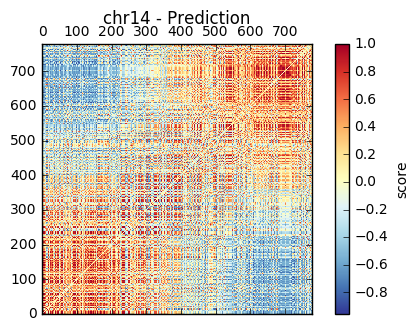

1.0
(779, 779)
Limit: 1.0


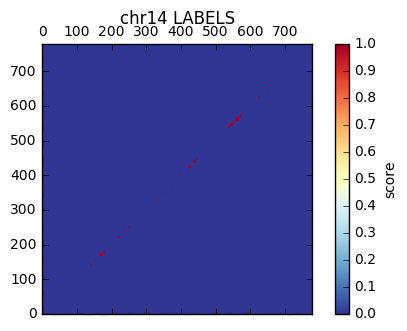

1.0
(779, 779)
Limit: 1.0


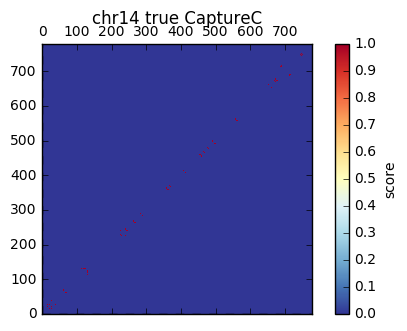

27.892651362
(779, 779)
Limit: 27.892651362


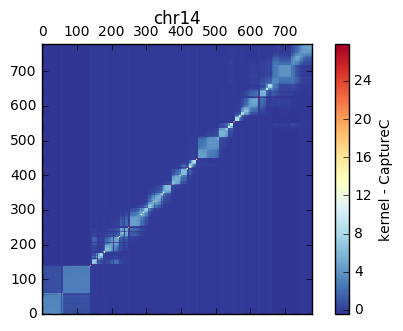

chr15
Balanced Accuracy: 55.12%	auROC: 0.629	 auPRC: 0.612
Recall at 5% | 10% | 25% FDR: 0.1% | 0.1% | 6.9%	Num Positives: 1603	 Num Negatives: 1603

chr15
0.99999999836
(629, 629)
Limit: 0.99999999836


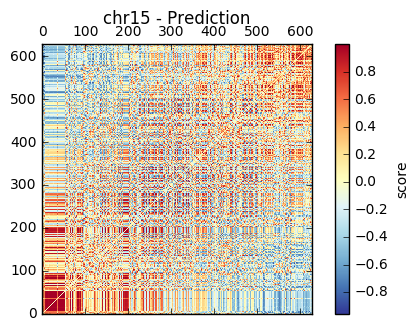

1.0
(629, 629)
Limit: 1.0


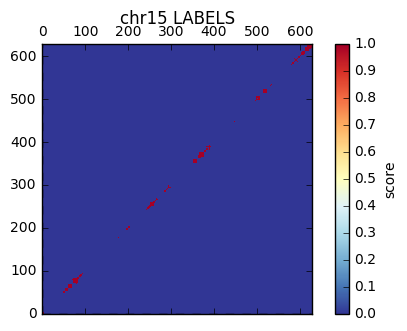

1.0
(629, 629)
Limit: 1.0


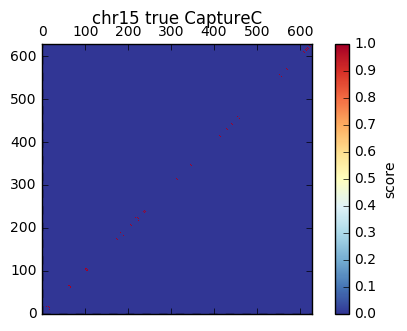

25.0599281723
(629, 629)
Limit: 25.0599281723


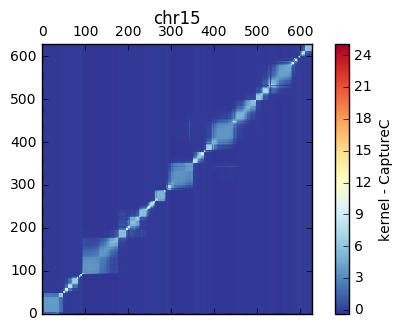

chr16
Balanced Accuracy: 59.15%	auROC: 0.671	 auPRC: 0.696
Recall at 5% | 10% | 25% FDR: 13.9% | 17.6% | 27.5%	Num Positives: 590	 Num Negatives: 590

chr16
0.999999997732
(726, 726)
Limit: 0.999999997732


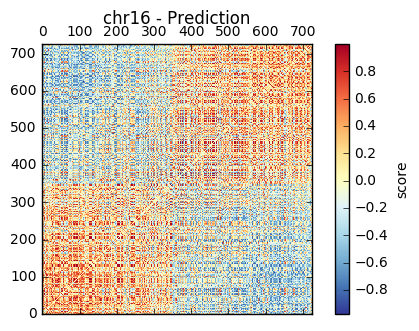

1.0
(726, 726)
Limit: 1.0


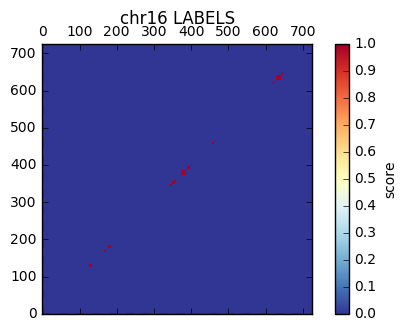

1.0
(726, 726)
Limit: 1.0


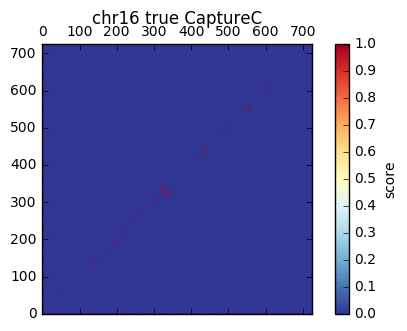

26.9258240357
(726, 726)
Limit: 26.9258240357


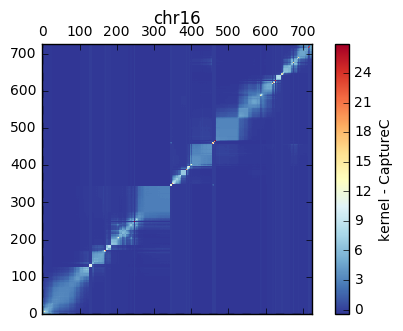

chr17
Balanced Accuracy: 56.02%	auROC: 0.670	 auPRC: 0.637
Recall at 5% | 10% | 25% FDR: 1.9% | 3.1% | 5.0%	Num Positives: 515	 Num Negatives: 515

chr17
0.999999998917
(1057, 1057)
Limit: 0.999999998917


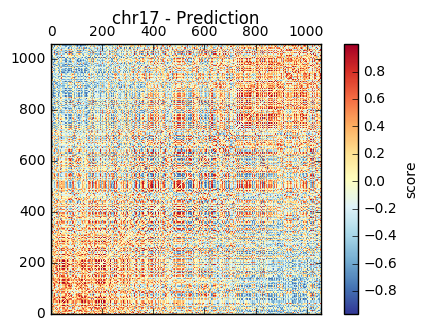

1.0
(1057, 1057)
Limit: 1.0


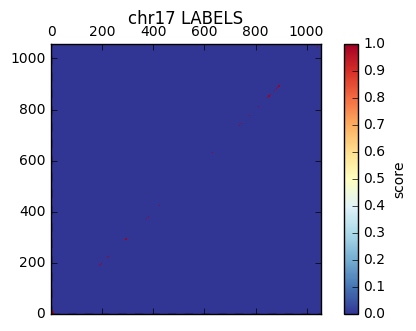

1.0
(1057, 1057)
Limit: 1.0


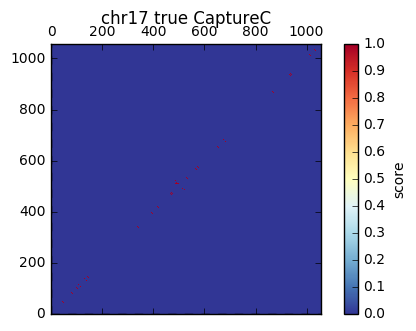

32.4961536185
(1057, 1057)
Limit: 32.4961536185


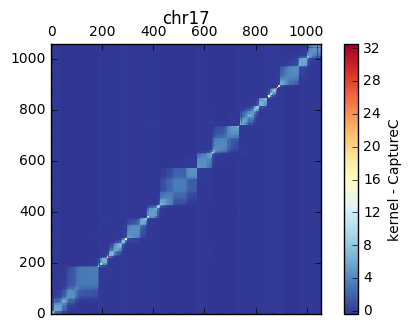

chr18
Balanced Accuracy: 57.49%	auROC: 0.658	 auPRC: 0.650
Recall at 5% | 10% | 25% FDR: 4.8% | 6.0% | 10.6%	Num Positives: 1710	 Num Negatives: 1710

chr18
0.999999973164
(352, 352)
Limit: 0.999999973164


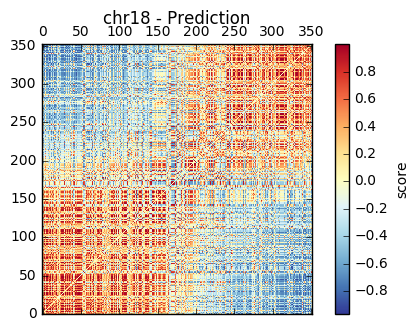

1.0
(352, 352)
Limit: 1.0


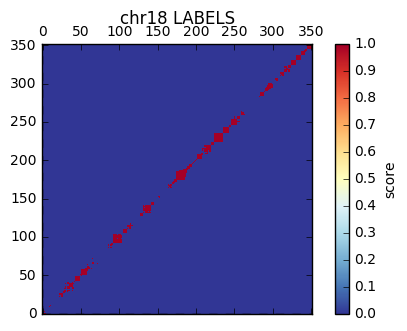

1.0
(352, 352)
Limit: 1.0


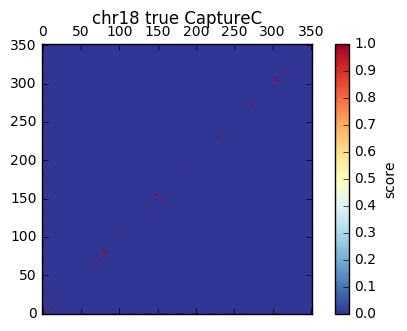

18.7349939952
(352, 352)
Limit: 18.7349939952


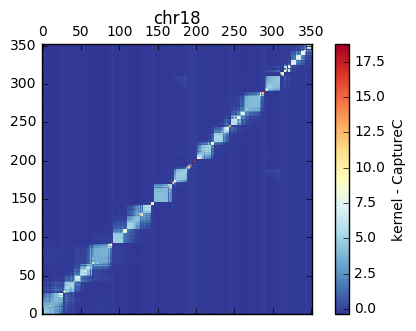

chr19
Balanced Accuracy: 63.36%	auROC: 0.670	 auPRC: 0.707
Recall at 5% | 10% | 25% FDR: 20.5% | 24.7% | 38.4%	Num Positives: 146	 Num Negatives: 146

chr19
0.999999971635
(1052, 1052)
Limit: 0.999999971635


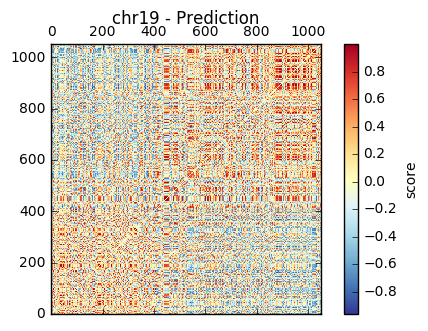

1.0
(1052, 1052)
Limit: 1.0


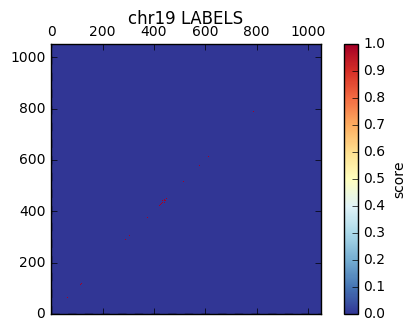

1.0
(1052, 1052)
Limit: 1.0


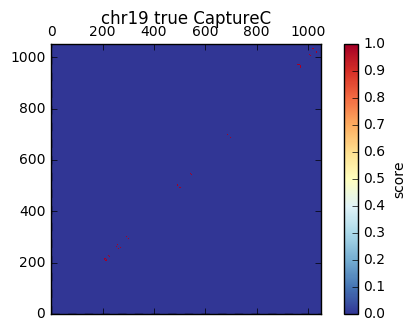

32.4191301549
(1052, 1052)
Limit: 32.4191301549


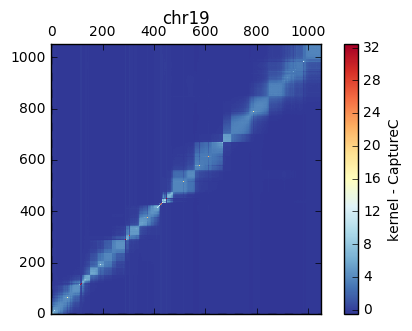

chr20
Balanced Accuracy: 58.21%	auROC: 0.684	 auPRC: 0.687
Recall at 5% | 10% | 25% FDR: 14.8% | 18.9% | 25.5%	Num Positives: 487	 Num Negatives: 487

chr20
0.999999996992
(619, 619)
Limit: 0.999999996992


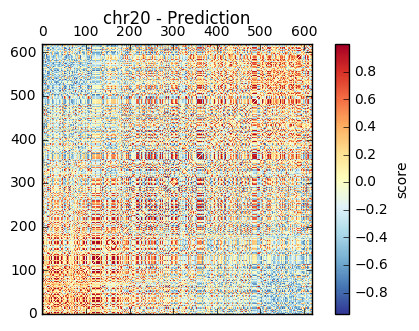

1.0
(619, 619)
Limit: 1.0


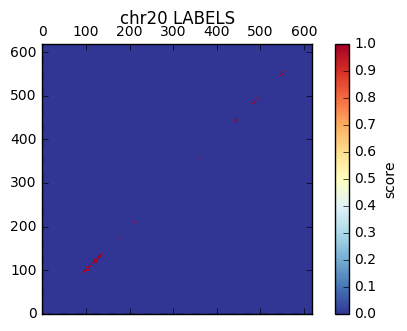

1.0
(619, 619)
Limit: 1.0


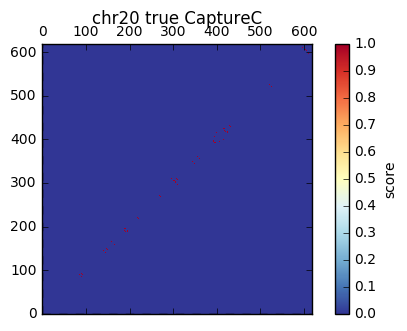

24.4210869748
(619, 619)
Limit: 24.4210869748


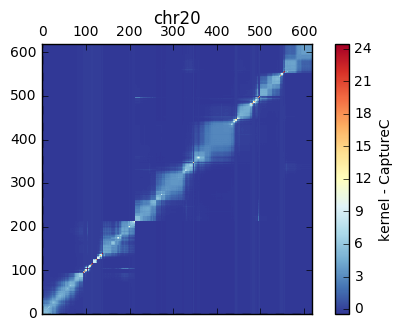

chr21
Balanced Accuracy: 53.80%	auROC: 0.549	 auPRC: 0.610
Recall at 5% | 10% | 25% FDR: 15.2% | 16.3% | 19.3%	Num Positives: 881	 Num Negatives: 881

chr21
0.999999998598
(280, 280)
Limit: 0.999999998598


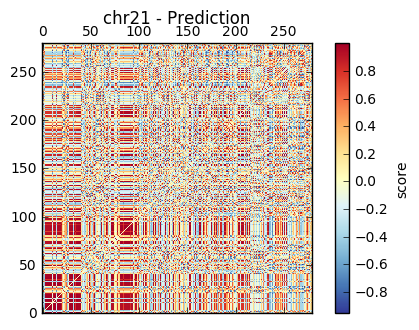

1.0
(280, 280)
Limit: 1.0


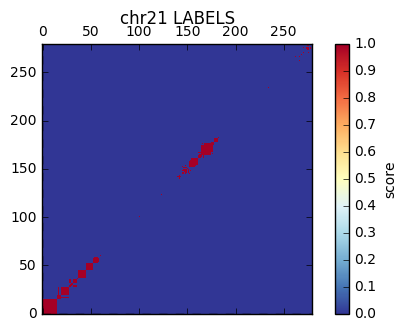

1.0
(280, 280)
Limit: 1.0


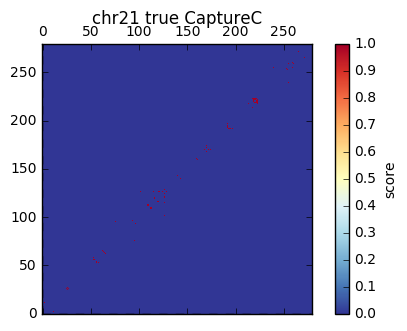

16.7032930885
(280, 280)
Limit: 16.7032930885


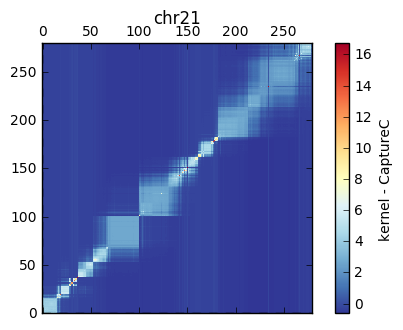

chr22
Balanced Accuracy: 58.22%	auROC: 0.670	 auPRC: 0.655
Recall at 5% | 10% | 25% FDR: 5.3% | 8.0% | 9.8%	Num Positives: 225	 Num Negatives: 225

chr22
0.999999641878
(431, 431)
Limit: 0.999999641878


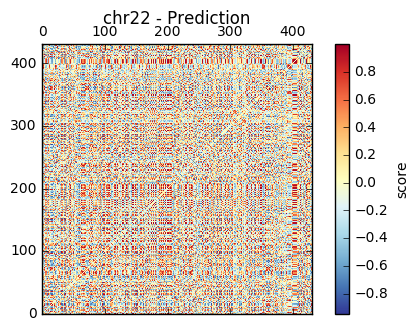

1.0
(431, 431)
Limit: 1.0


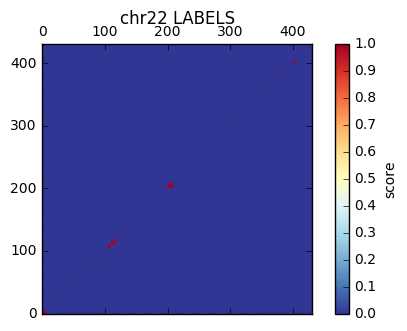

1.0
(431, 431)
Limit: 1.0


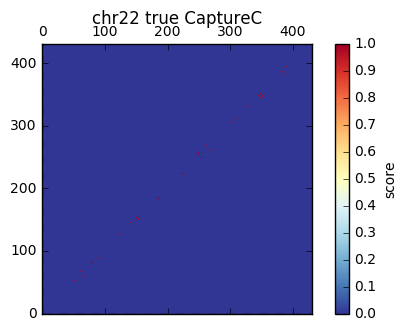

20.7364413533
(431, 431)
Limit: 20.7364413533


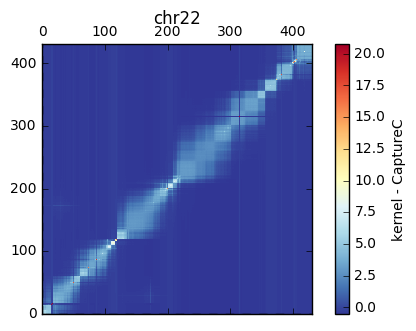

chrX
Balanced Accuracy: 68.28%	auROC: 0.772	 auPRC: 0.772
Recall at 5% | 10% | 25% FDR: 21.6% | 22.9% | 42.5%	Num Positives: 2970	 Num Negatives: 2970

chrX
0.999999999965
(861, 861)
Limit: 0.999999999965


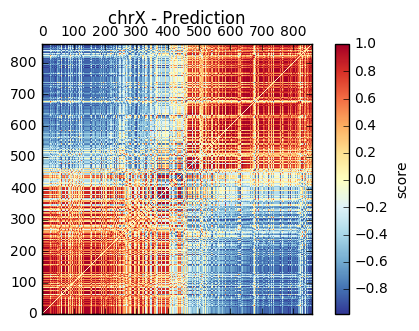

1.0
(861, 861)
Limit: 1.0


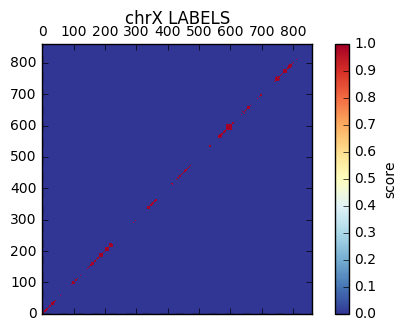

1.0
(861, 861)
Limit: 1.0


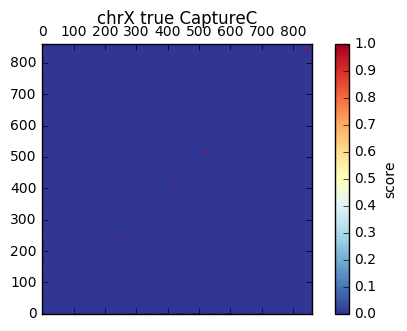

29.3257565972
(861, 861)
Limit: 29.3257565972


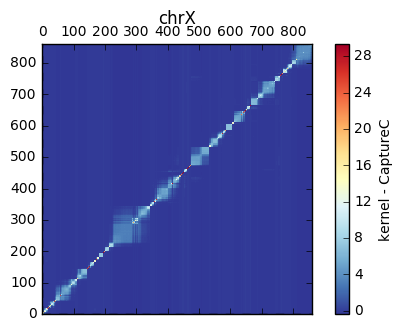

chr1 ROC= 0.748989158163 PRC= 0.742176600652
chr2 ROC= 0.709446293557 PRC= 0.692282673138
chr3 ROC= 0.720177360499 PRC= 0.70617258634
chr4 ROC= 0.699006619488 PRC= 0.678348379291
chr5 ROC= 0.688404736551 PRC= 0.694161173366
chr6 ROC= 0.682072600944 PRC= 0.673116907804
chr7 ROC= 0.697094177528 PRC= 0.693792729136
chr8 ROC= 0.70161377824 PRC= 0.684094246924
chr9 ROC= 0.65405938064 PRC= 0.664994489116
chr10 ROC= 0.663379190922 PRC= 0.670622198673
chr11 ROC= 0.689550394924 PRC= 0.669445498922
chr12 ROC= 0.669761313252 PRC= 0.674918733081
chr13 ROC= 0.631925035044 PRC= 0.657907328667
chr14 ROC= 0.633323073766 PRC= 0.63046966522
chr15 ROC= 0.628737484964 PRC= 0.611604106461
chr16 ROC= 0.670893421431 PRC= 0.695586871929
chr17 ROC= 0.670353473466 PRC= 0.637089721296
chr18 ROC= 0.65821825519 PRC= 0.650416828393
chr19 ROC= 0.670388440608 PRC= 0.707124043973
chr20 ROC= 0.683727637254 PRC= 0.687318848612
chr21 ROC= 0.549491020549 PRC= 0.609783338387
chr22 ROC= 0.669787654321 PRC= 0.654732179346
ch

In [16]:
performance_on_pos_and_neg_subsmpl(0.05)

chr1
Balanced Accuracy: 62.54%	auROC: 0.703	 auPRC: 0.695
Recall at 5% | 10% | 25% FDR: 6.3% | 8.3% | 25.3%	Num Positives: 5532	 Num Negatives: 5532

chr1
0.999999999901
(2272, 2272)
Limit: 0.999999999901


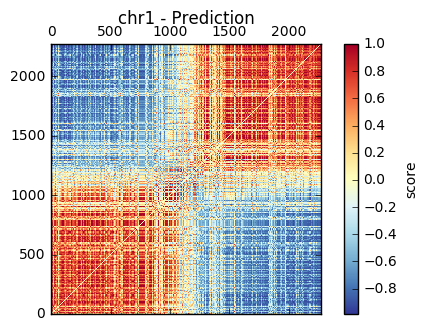

1.0
(2272, 2272)
Limit: 1.0


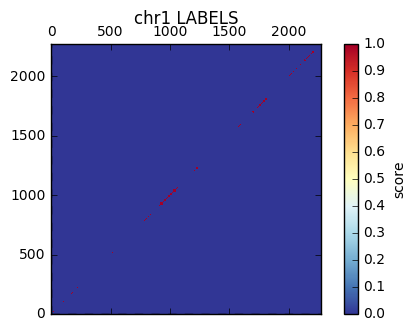

1.0
(2272, 2272)
Limit: 1.0


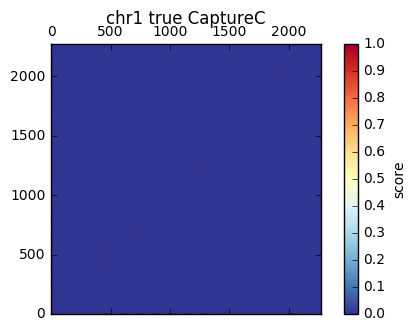

47.6550102298
(2272, 2272)
Limit: 47.6550102298


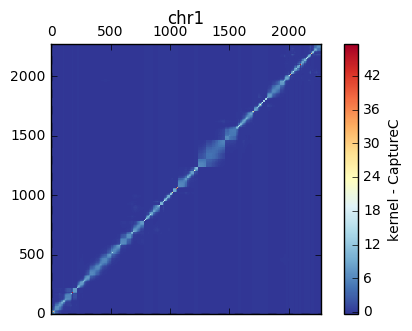

chr2
Balanced Accuracy: 63.77%	auROC: 0.735	 auPRC: 0.708
Recall at 5% | 10% | 25% FDR: 7.5% | 8.9% | 21.6%	Num Positives: 10763	 Num Negatives: 10763

chr2
0.999999999963
(1604, 1604)
Limit: 0.999999999963


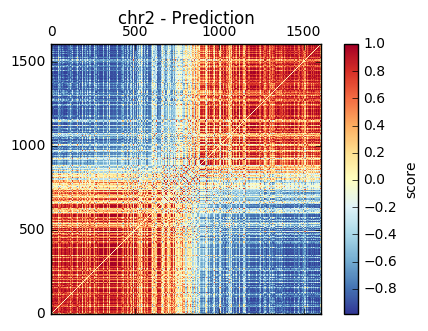

1.0
(1604, 1604)
Limit: 1.0


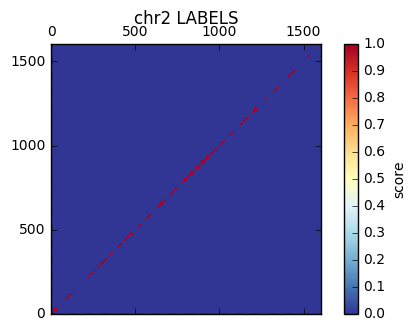

1.0
(1604, 1604)
Limit: 1.0


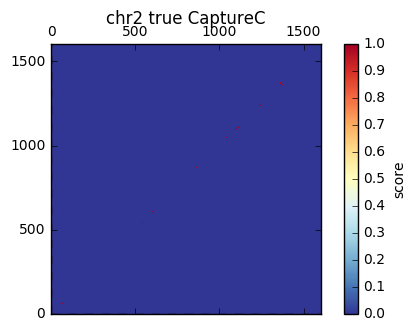

40.0374824383
(1604, 1604)
Limit: 40.0374824383


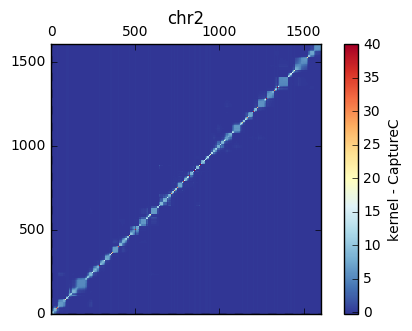

chr3
Balanced Accuracy: 62.67%	auROC: 0.720	 auPRC: 0.698
Recall at 5% | 10% | 25% FDR: 5.9% | 7.0% | 19.6%	Num Positives: 7838	 Num Negatives: 7838

chr3
0.99999999985
(1331, 1331)
Limit: 0.99999999985


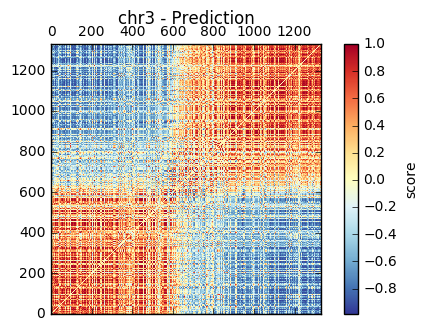

1.0
(1331, 1331)
Limit: 1.0


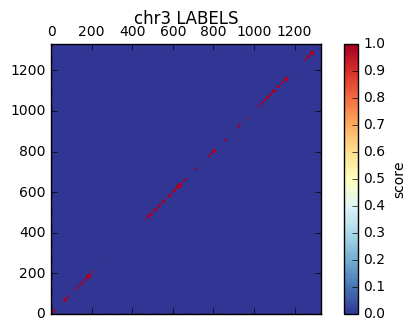

1.0
(1331, 1331)
Limit: 1.0


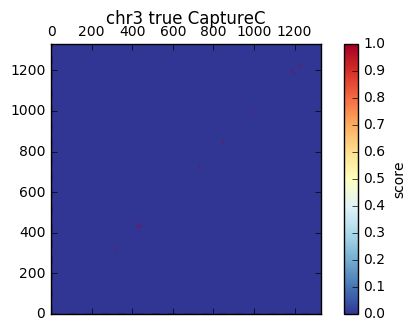

36.4691650576
(1331, 1331)
Limit: 36.4691650576


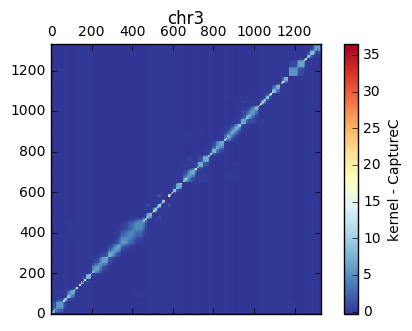

chr4
Balanced Accuracy: 61.32%	auROC: 0.702	 auPRC: 0.678
Recall at 5% | 10% | 25% FDR: 4.4% | 4.8% | 16.7%	Num Positives: 9499	 Num Negatives: 9499

chr4
0.99999999998
(947, 947)
Limit: 0.99999999998


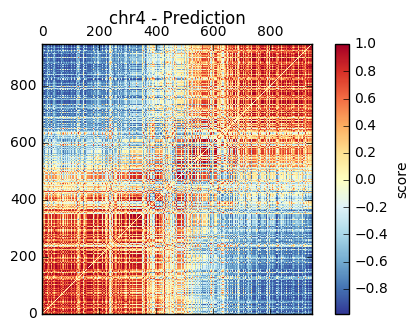

1.0
(947, 947)
Limit: 1.0


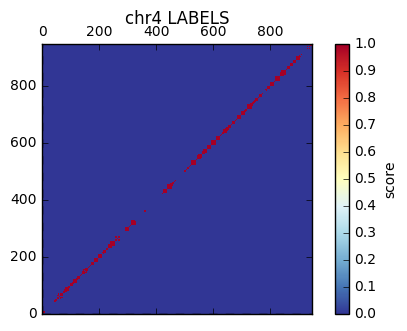

1.0
(947, 947)
Limit: 1.0


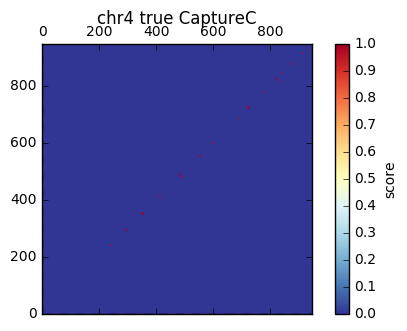

30.7571129985
(947, 947)
Limit: 30.7571129985


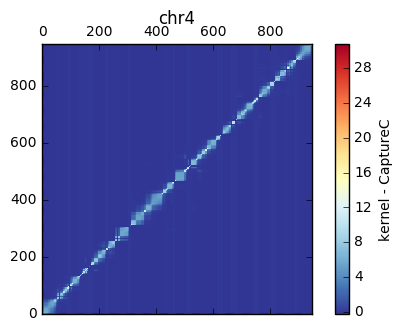

chr5
Balanced Accuracy: 61.98%	auROC: 0.696	 auPRC: 0.688
Recall at 5% | 10% | 25% FDR: 5.2% | 6.3% | 26.0%	Num Positives: 7483	 Num Negatives: 7483

chr5
0.999999998942
(1117, 1117)
Limit: 0.999999998942


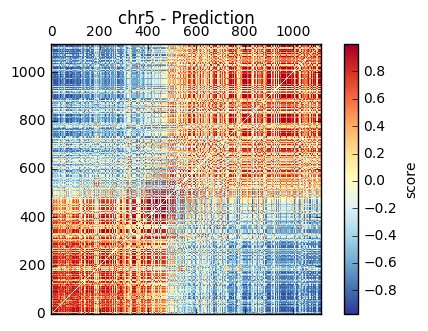

1.0
(1117, 1117)
Limit: 1.0


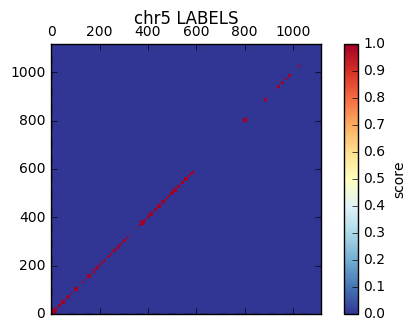

1.0
(1117, 1117)
Limit: 1.0


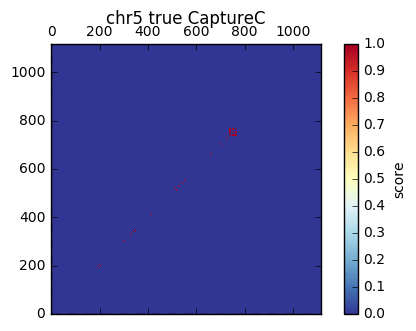

33.406586177
(1117, 1117)
Limit: 33.406586177


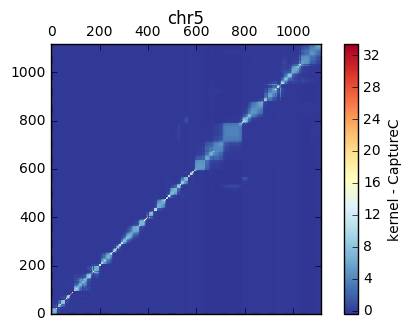

chr6
Balanced Accuracy: 65.56%	auROC: 0.738	 auPRC: 0.720
Recall at 5% | 10% | 25% FDR: 5.3% | 6.4% | 35.3%	Num Positives: 9662	 Num Negatives: 9662

chr6
0.999999999971
(1224, 1224)
Limit: 0.999999999971


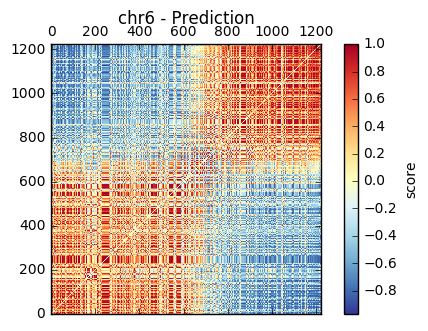

1.0
(1224, 1224)
Limit: 1.0


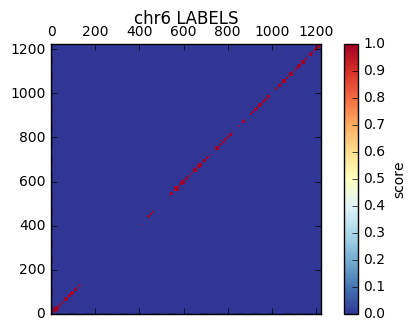

1.0
(1224, 1224)
Limit: 1.0


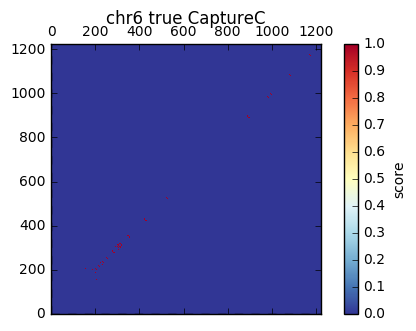

34.9714169001
(1224, 1224)
Limit: 34.9714169001


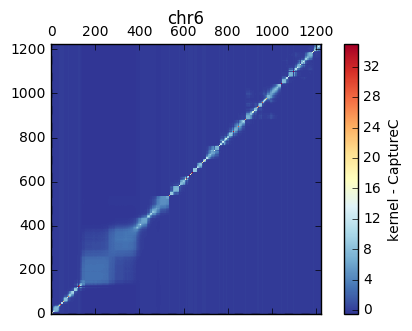

chr7
Balanced Accuracy: 59.89%	auROC: 0.692	 auPRC: 0.679
Recall at 5% | 10% | 25% FDR: 6.3% | 7.0% | 17.7%	Num Positives: 9134	 Num Negatives: 9134

chr7
0.999999999772
(1020, 1020)
Limit: 0.999999999772


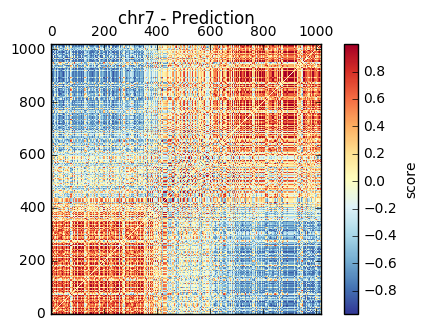

1.0
(1020, 1020)
Limit: 1.0


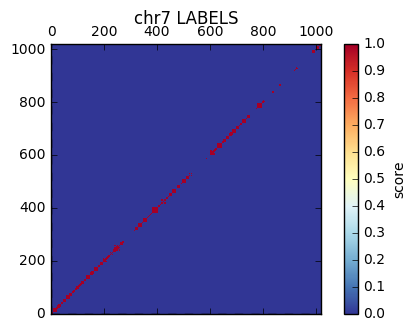

1.0
(1020, 1020)
Limit: 1.0


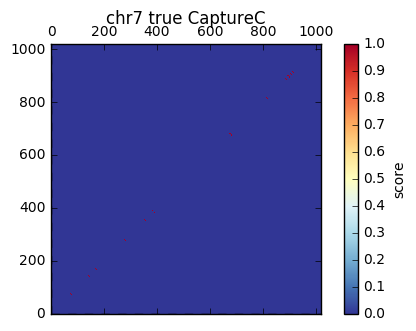

31.921779399
(1020, 1020)
Limit: 31.921779399


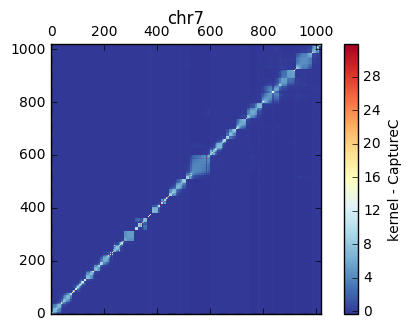

chr8
Balanced Accuracy: 58.42%	auROC: 0.652	 auPRC: 0.655
Recall at 5% | 10% | 25% FDR: 7.4% | 7.9% | 17.7%	Num Positives: 6870	 Num Negatives: 6870

chr8
0.999999999858
(897, 897)
Limit: 0.999999999858


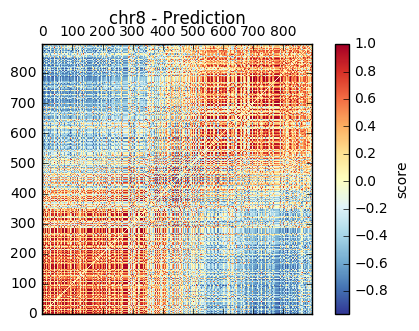

1.0
(897, 897)
Limit: 1.0


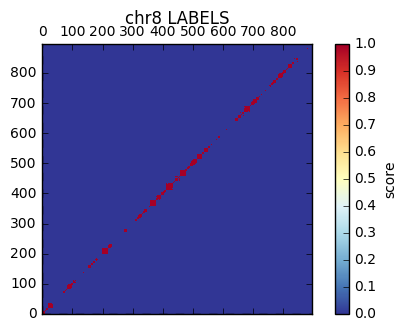

1.0
(897, 897)
Limit: 1.0


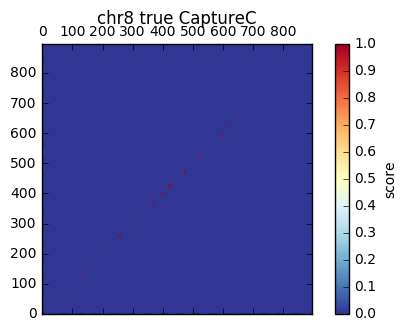

29.9332590942
(897, 897)
Limit: 29.9332590942


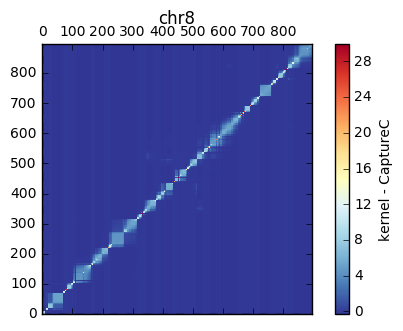

chr9
Balanced Accuracy: 59.78%	auROC: 0.671	 auPRC: 0.667
Recall at 5% | 10% | 25% FDR: 3.9% | 4.6% | 19.7%	Num Positives: 5526	 Num Negatives: 5526

chr9
0.999999998112
(859, 859)
Limit: 0.999999998112


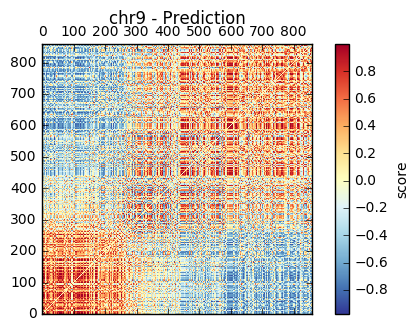

1.0
(859, 859)
Limit: 1.0


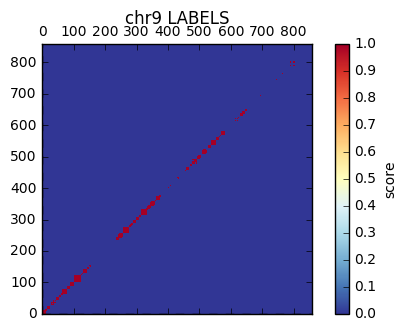

1.0
(859, 859)
Limit: 1.0


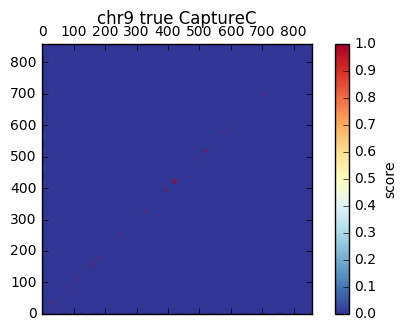

29.2916370318
(859, 859)
Limit: 29.2916370318


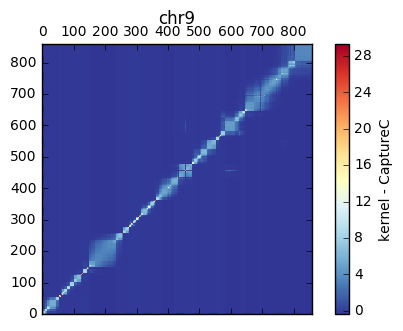

chr10
Balanced Accuracy: 60.21%	auROC: 0.684	 auPRC: 0.678
Recall at 5% | 10% | 25% FDR: 5.6% | 6.2% | 18.9%	Num Positives: 6969	 Num Negatives: 6969

chr10
0.999999999951
(943, 943)
Limit: 0.999999999951


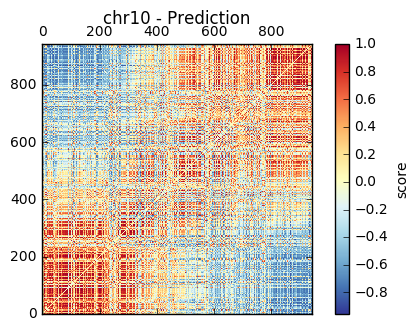

1.0
(943, 943)
Limit: 1.0


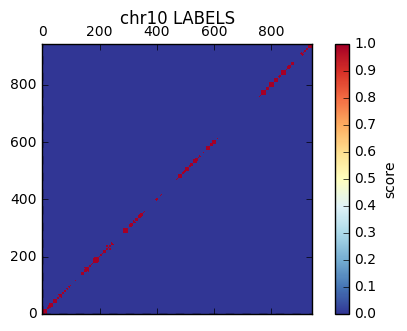

1.0
(943, 943)
Limit: 1.0


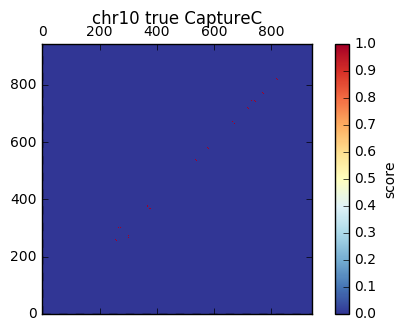

30.6920185064
(943, 943)
Limit: 30.6920185064


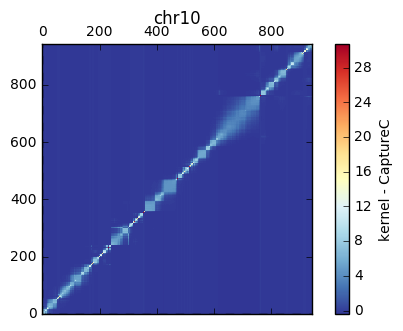

chr11
Balanced Accuracy: 59.54%	auROC: 0.677	 auPRC: 0.659
Recall at 5% | 10% | 25% FDR: 1.4% | 4.0% | 6.7%	Num Positives: 4019	 Num Negatives: 4019

chr11
0.999999999706
(1401, 1401)
Limit: 0.999999999706


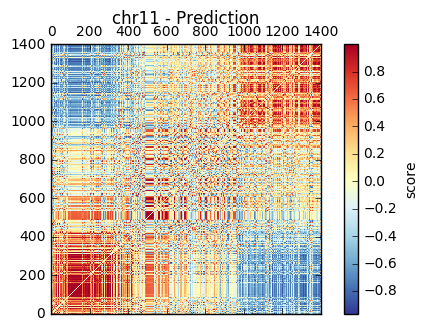

1.0
(1401, 1401)
Limit: 1.0


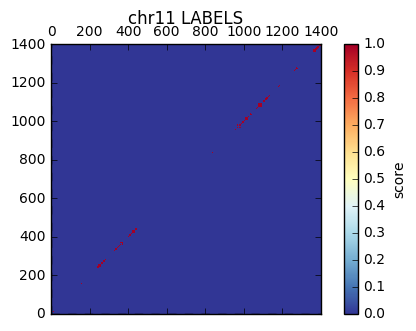

1.0
(1401, 1401)
Limit: 1.0


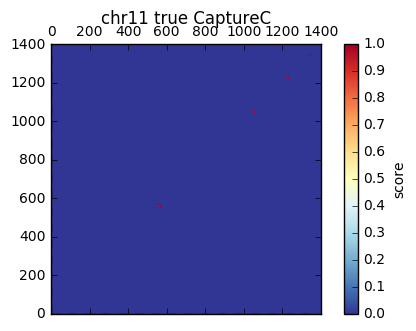

37.4165738677
(1401, 1401)
Limit: 37.4165738677


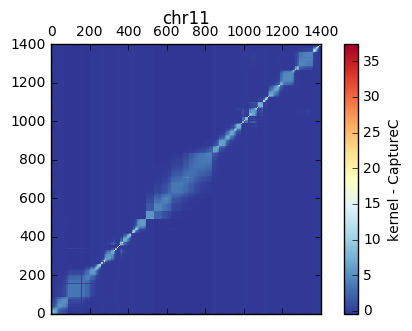

chr12
Balanced Accuracy: 59.81%	auROC: 0.684	 auPRC: 0.678
Recall at 5% | 10% | 25% FDR: 6.0% | 6.3% | 21.8%	Num Positives: 5800	 Num Negatives: 5800

chr12
0.999999999986
(1200, 1200)
Limit: 0.999999999986


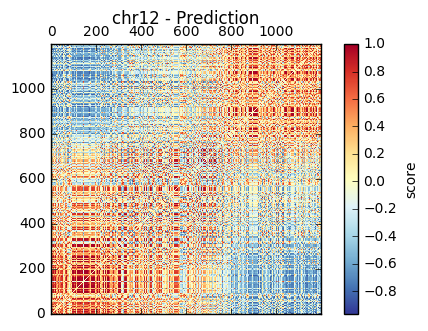

1.0
(1200, 1200)
Limit: 1.0


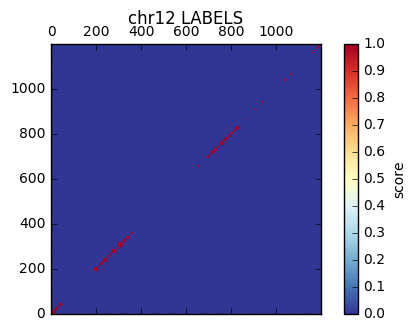

1.0
(1200, 1200)
Limit: 1.0


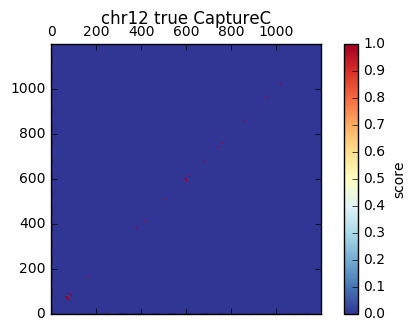

34.6265793864
(1200, 1200)
Limit: 34.6265793864


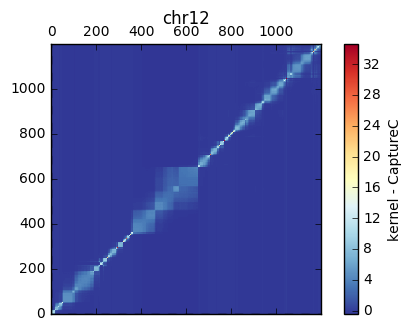

chr13
Balanced Accuracy: 54.17%	auROC: 0.605	 auPRC: 0.604
Recall at 5% | 10% | 25% FDR: 4.3% | 5.1% | 7.4%	Num Positives: 5233	 Num Negatives: 5233

chr13
0.999999976902
(452, 452)
Limit: 0.999999976902


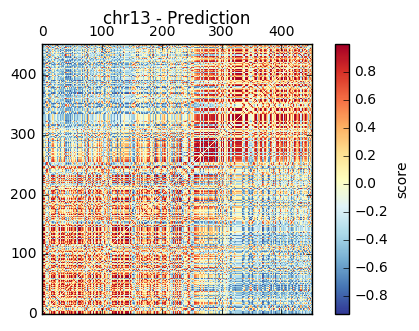

1.0
(452, 452)
Limit: 1.0


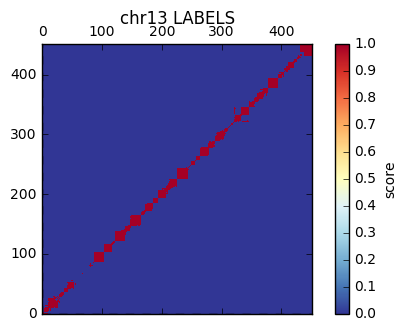

1.0
(452, 452)
Limit: 1.0


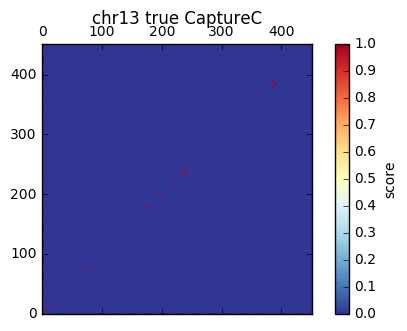

21.2367605816
(452, 452)
Limit: 21.2367605816


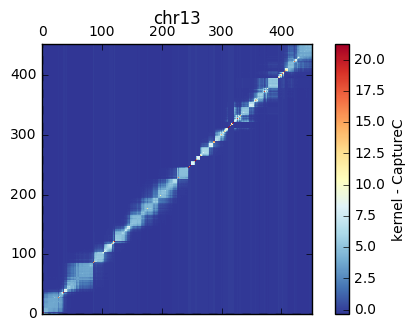

chr14
Balanced Accuracy: 55.28%	auROC: 0.599	 auPRC: 0.602
Recall at 5% | 10% | 25% FDR: 0.0% | 4.4% | 7.1%	Num Positives: 3163	 Num Negatives: 3163

chr14
0.999999999861
(779, 779)
Limit: 0.999999999861


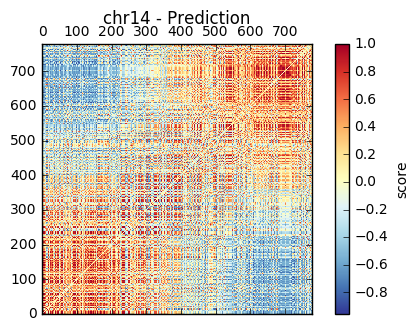

1.0
(779, 779)
Limit: 1.0


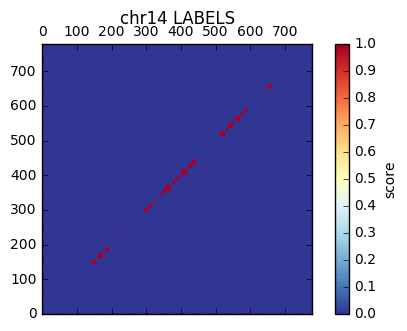

1.0
(779, 779)
Limit: 1.0


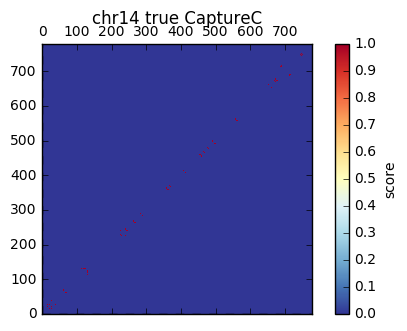

27.892651362
(779, 779)
Limit: 27.892651362


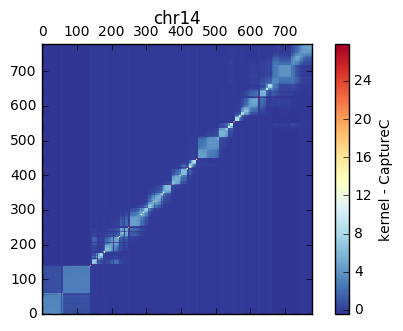

chr15
Balanced Accuracy: 55.45%	auROC: 0.600	 auPRC: 0.602
Recall at 5% | 10% | 25% FDR: 0.0% | 3.2% | 9.3%	Num Positives: 4359	 Num Negatives: 4359

chr15
0.99999999836
(629, 629)
Limit: 0.99999999836


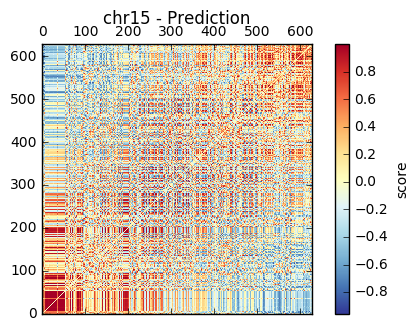

1.0
(629, 629)
Limit: 1.0


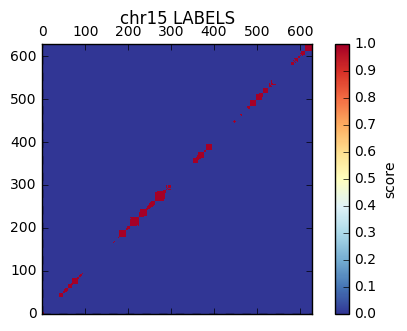

1.0
(629, 629)
Limit: 1.0


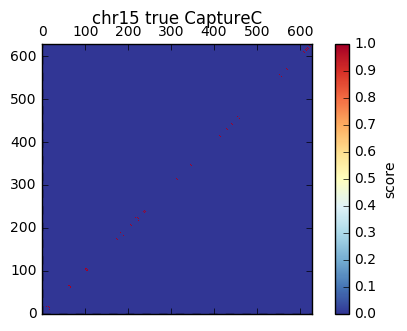

25.0599281723
(629, 629)
Limit: 25.0599281723


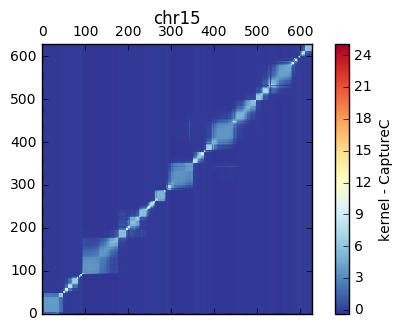

chr16
Balanced Accuracy: 56.80%	auROC: 0.640	 auPRC: 0.647
Recall at 5% | 10% | 25% FDR: 4.8% | 9.4% | 14.8%	Num Positives: 2067	 Num Negatives: 2067

chr16
0.999999997732
(726, 726)
Limit: 0.999999997732


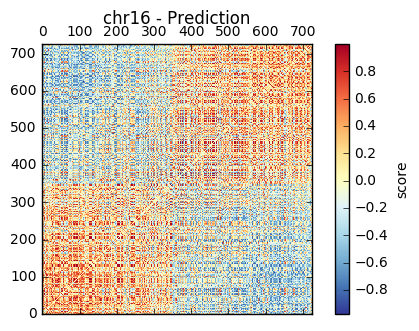

1.0
(726, 726)
Limit: 1.0


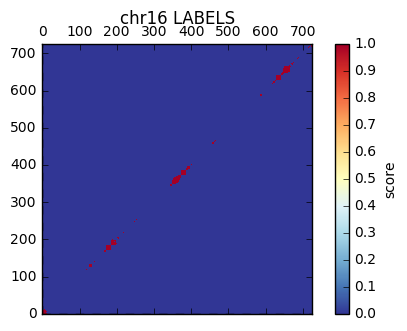

1.0
(726, 726)
Limit: 1.0


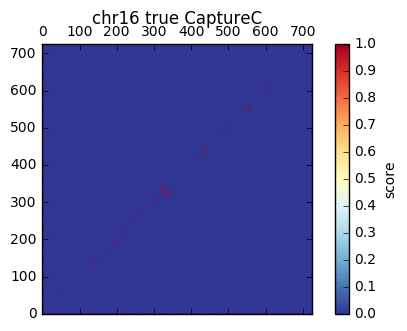

26.9258240357
(726, 726)
Limit: 26.9258240357


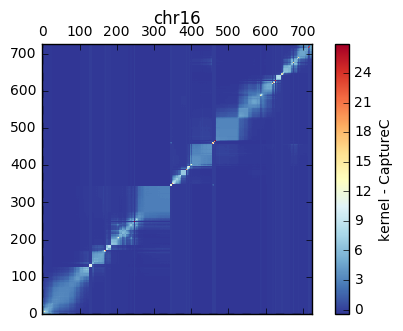

chr17
Balanced Accuracy: 57.01%	auROC: 0.644	 auPRC: 0.646
Recall at 5% | 10% | 25% FDR: 3.8% | 7.2% | 17.9%	Num Positives: 2909	 Num Negatives: 2909

chr17
0.999999998917
(1057, 1057)
Limit: 0.999999998917


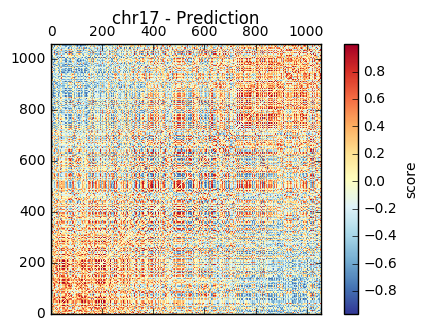

1.0
(1057, 1057)
Limit: 1.0


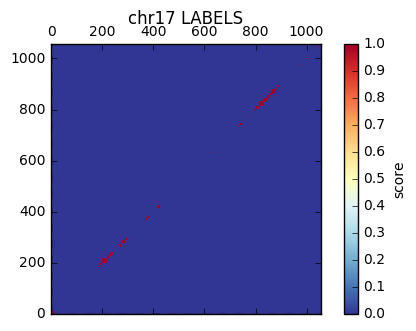

1.0
(1057, 1057)
Limit: 1.0


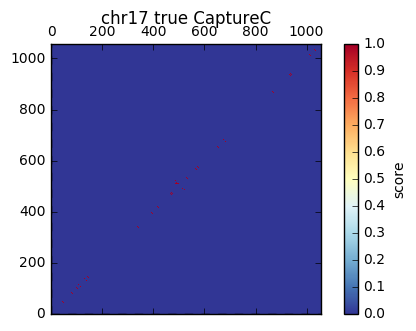

32.4961536185
(1057, 1057)
Limit: 32.4961536185


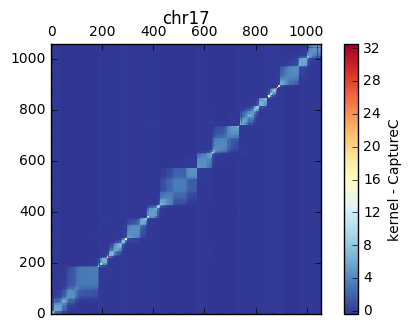

chr18
Balanced Accuracy: 57.74%	auROC: 0.670	 auPRC: 0.648
Recall at 5% | 10% | 25% FDR: 4.1% | 4.3% | 6.6%	Num Positives: 4394	 Num Negatives: 4394

chr18
0.999999973164
(352, 352)
Limit: 0.999999973164


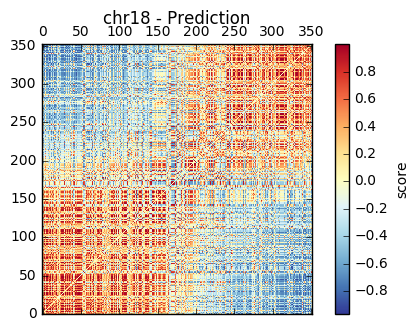

1.0
(352, 352)
Limit: 1.0


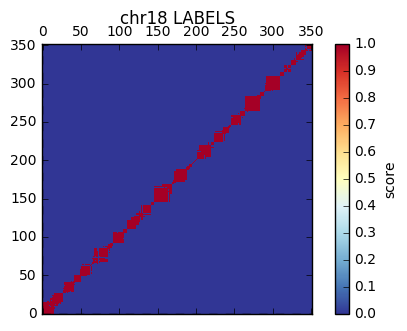

1.0
(352, 352)
Limit: 1.0


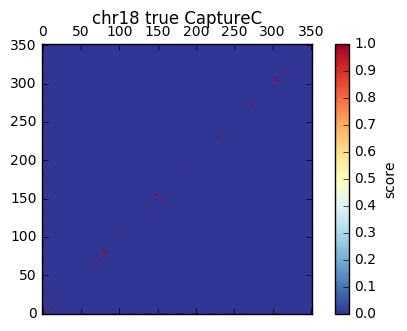

18.7349939952
(352, 352)
Limit: 18.7349939952


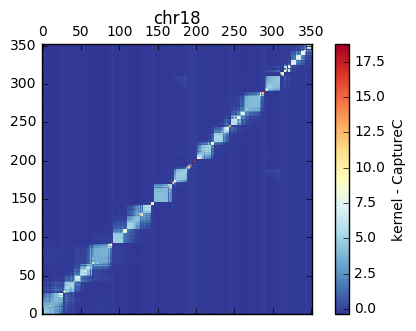

chr19
Balanced Accuracy: 55.43%	auROC: 0.569	 auPRC: 0.594
Recall at 5% | 10% | 25% FDR: 4.6% | 5.0% | 15.0%	Num Positives: 479	 Num Negatives: 479

chr19
0.999999971635
(1052, 1052)
Limit: 0.999999971635


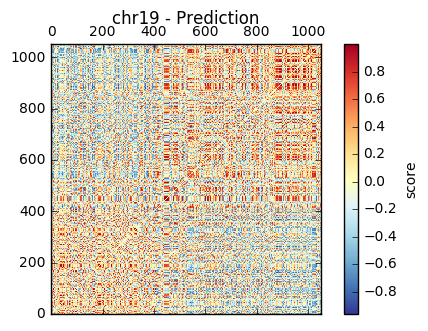

1.0
(1052, 1052)
Limit: 1.0


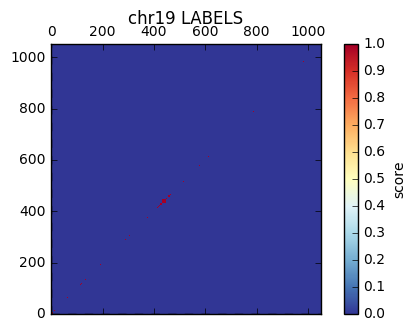

1.0
(1052, 1052)
Limit: 1.0


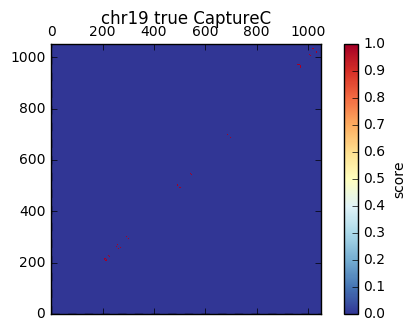

32.4191301549
(1052, 1052)
Limit: 32.4191301549


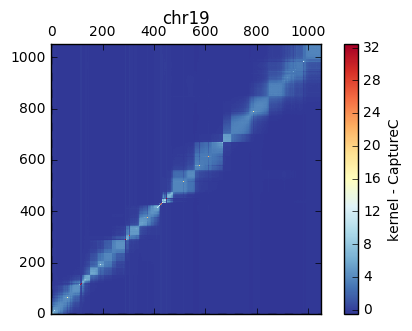

chr20
Balanced Accuracy: 57.83%	auROC: 0.674	 auPRC: 0.676
Recall at 5% | 10% | 25% FDR: 9.3% | 11.8% | 22.3%	Num Positives: 1674	 Num Negatives: 1674

chr20
0.999999996992
(619, 619)
Limit: 0.999999996992


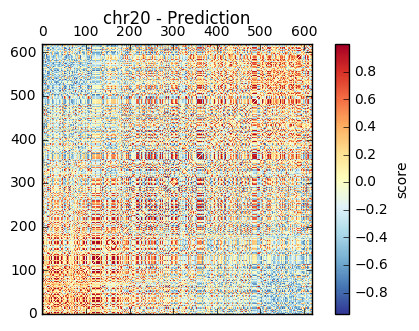

1.0
(619, 619)
Limit: 1.0


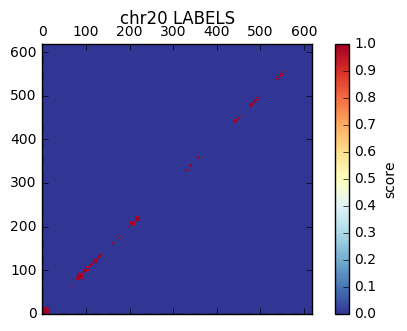

1.0
(619, 619)
Limit: 1.0


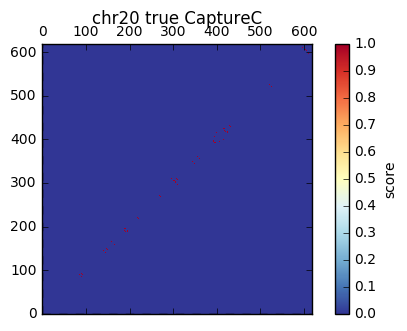

24.4210869748
(619, 619)
Limit: 24.4210869748


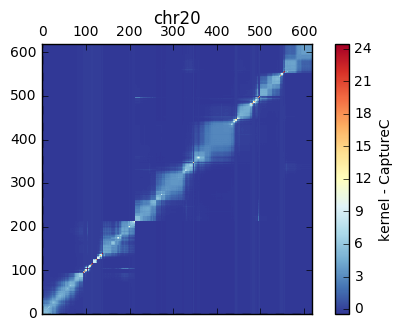

chr21
Balanced Accuracy: 51.68%	auROC: 0.517	 auPRC: 0.554
Recall at 5% | 10% | 25% FDR: 1.7% | 9.1% | 9.8%	Num Positives: 1635	 Num Negatives: 1635

chr21
0.999999998598
(280, 280)
Limit: 0.999999998598


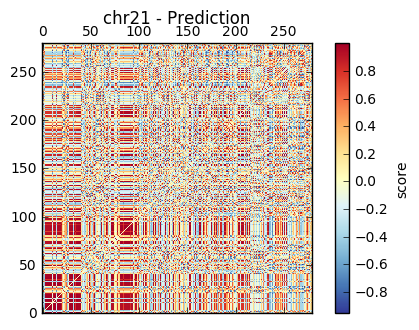

1.0
(280, 280)
Limit: 1.0


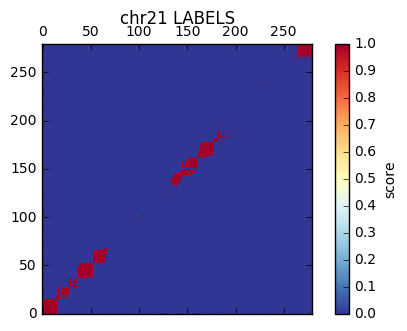

1.0
(280, 280)
Limit: 1.0


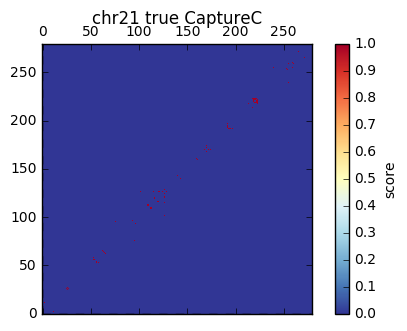

16.7032930885
(280, 280)
Limit: 16.7032930885


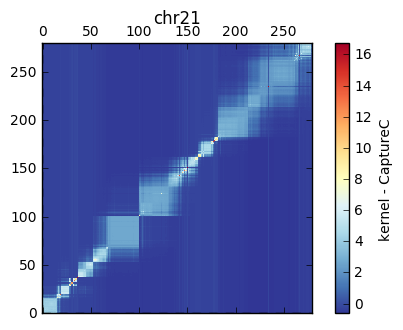

chr22
Balanced Accuracy: 52.24%	auROC: 0.544	 auPRC: 0.554
Recall at 5% | 10% | 25% FDR: 0.6% | 1.6% | 4.5%	Num Positives: 1788	 Num Negatives: 1788

chr22
0.999999641878
(431, 431)
Limit: 0.999999641878


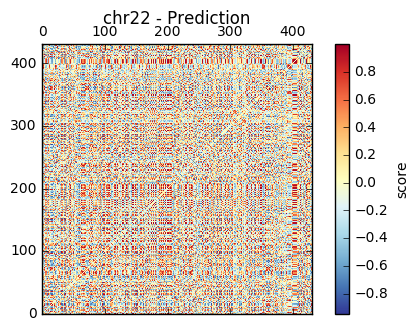

1.0
(431, 431)
Limit: 1.0


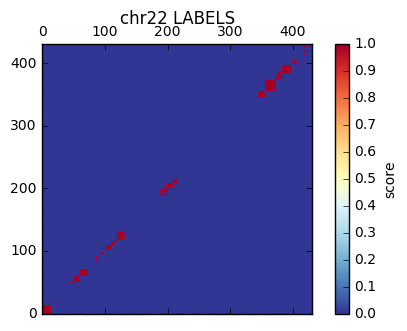

1.0
(431, 431)
Limit: 1.0


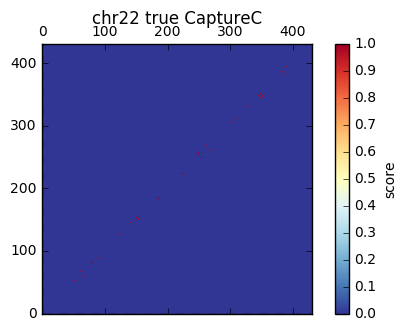

20.7364413533
(431, 431)
Limit: 20.7364413533


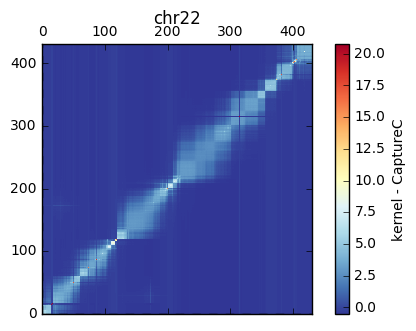

chrX
Balanced Accuracy: 66.55%	auROC: 0.760	 auPRC: 0.749
Recall at 5% | 10% | 25% FDR: 16.0% | 17.1% | 34.4%	Num Positives: 6596	 Num Negatives: 6596

chrX
0.999999999965
(861, 861)
Limit: 0.999999999965


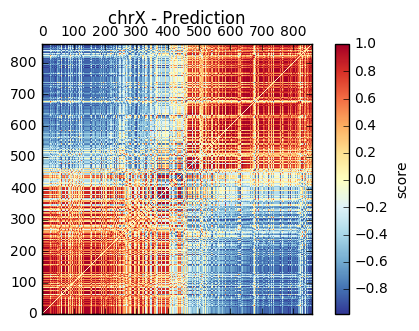

1.0
(861, 861)
Limit: 1.0


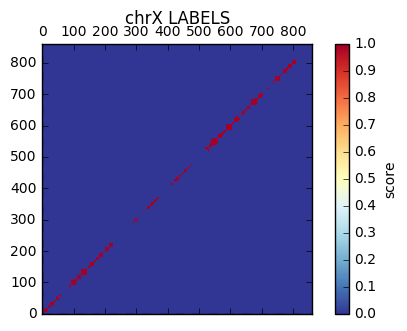

1.0
(861, 861)
Limit: 1.0


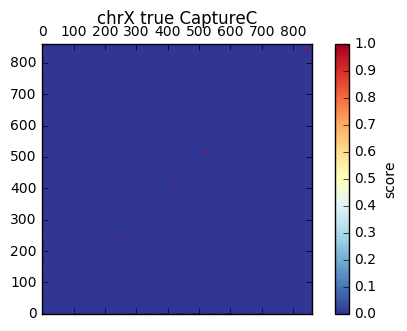

29.3257565972
(861, 861)
Limit: 29.3257565972


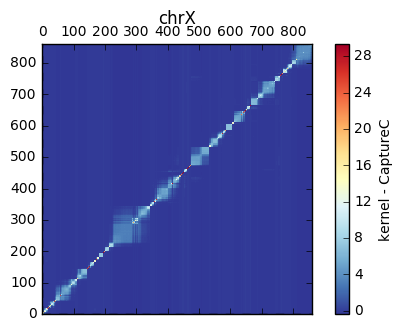

chr1 ROC= 0.703044738324 PRC= 0.695147757113
chr2 ROC= 0.735482473571 PRC= 0.7082598209
chr3 ROC= 0.719755483603 PRC= 0.697538788408
chr4 ROC= 0.702157111168 PRC= 0.6778766282
chr5 ROC= 0.696147992021 PRC= 0.68829630625
chr6 ROC= 0.737581807207 PRC= 0.719685147949
chr7 ROC= 0.692271322785 PRC= 0.679089154636
chr8 ROC= 0.652175291174 PRC= 0.655428867786
chr9 ROC= 0.671290942079 PRC= 0.666805863315
chr10 ROC= 0.684008991215 PRC= 0.677608147715
chr11 ROC= 0.677472816513 PRC= 0.659026124463
chr12 ROC= 0.684151248514 PRC= 0.6776339637
chr13 ROC= 0.605461584195 PRC= 0.603927617082
chr14 ROC= 0.598541426422 PRC= 0.6019559607
chr15 ROC= 0.599642984975 PRC= 0.601776342923
chr16 ROC= 0.6400746731 PRC= 0.646634046868
chr17 ROC= 0.644457150501 PRC= 0.64614506028
chr18 ROC= 0.669994400027 PRC= 0.647543284044
chr19 ROC= 0.568910961859 PRC= 0.594363957092
chr20 ROC= 0.673820137631 PRC= 0.676274181815
chr21 ROC= 0.517098074423 PRC= 0.554408843877
chr22 ROC= 0.544105245509 PRC= 0.553662409275
chrX ROC=

In [10]:
performance_on_pos_and_neg_subsmpl(0.03)

chr1
Balanced Accuracy: 66.58%	auROC: 0.756	 auPRC: 0.717
Recall at 5% | 10% | 25% FDR: 3.9% | 4.7% | 22.3%	Num Positives: 77121	 Num Negatives: 77121

chr1
0.999999999901
(2272, 2272)
Limit: 0.999999999901


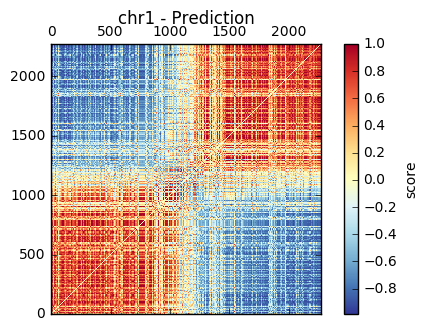

1.0
(2272, 2272)
Limit: 1.0


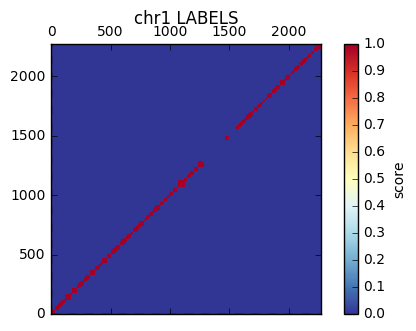

1.0
(2272, 2272)
Limit: 1.0


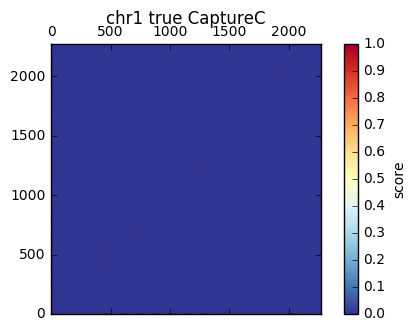

47.6550102298
(2272, 2272)
Limit: 47.6550102298


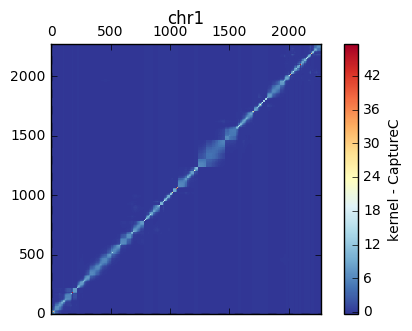

chr2
Balanced Accuracy: 67.02%	auROC: 0.759	 auPRC: 0.709
Recall at 5% | 10% | 25% FDR: 3.8% | 4.3% | 8.9%	Num Positives: 55180	 Num Negatives: 55180

chr2
0.999999999963
(1604, 1604)
Limit: 0.999999999963


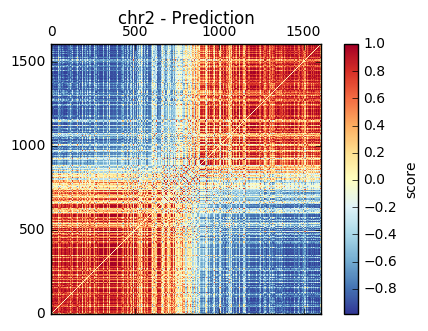

1.0
(1604, 1604)
Limit: 1.0


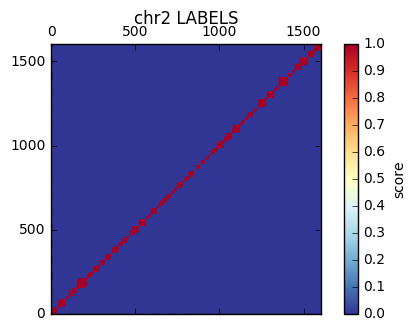

1.0
(1604, 1604)
Limit: 1.0


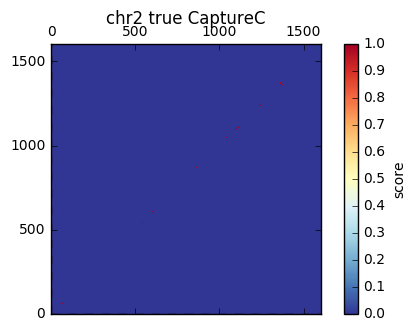

40.0374824383
(1604, 1604)
Limit: 40.0374824383


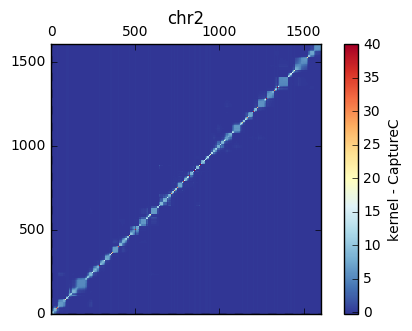

chr3
Balanced Accuracy: 62.38%	auROC: 0.726	 auPRC: 0.685
Recall at 5% | 10% | 25% FDR: 3.3% | 3.7% | 8.0%	Num Positives: 43441	 Num Negatives: 43441

chr3
0.99999999985
(1331, 1331)
Limit: 0.99999999985


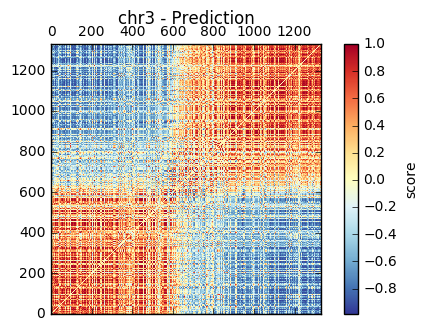

1.0
(1331, 1331)
Limit: 1.0


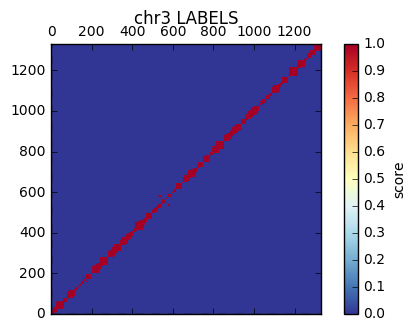

1.0
(1331, 1331)
Limit: 1.0


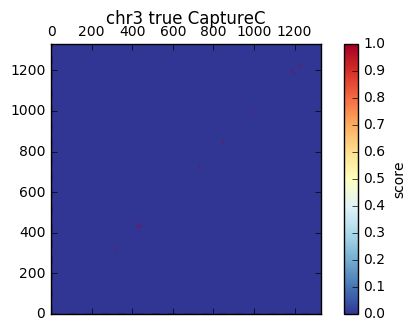

36.4691650576
(1331, 1331)
Limit: 36.4691650576


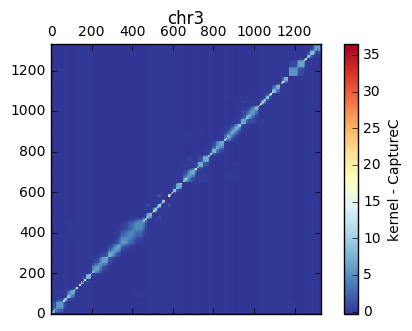

chr4
Balanced Accuracy: 64.10%	auROC: 0.726	 auPRC: 0.706
Recall at 5% | 10% | 25% FDR: 4.7% | 6.1% | 23.8%	Num Positives: 27743	 Num Negatives: 27743

chr4
0.99999999998
(947, 947)
Limit: 0.99999999998


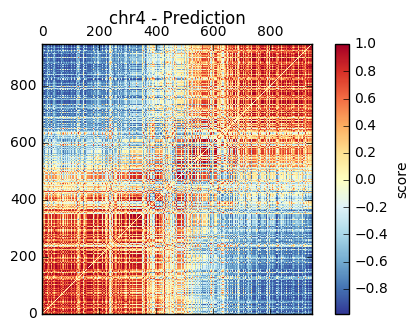

1.0
(947, 947)
Limit: 1.0


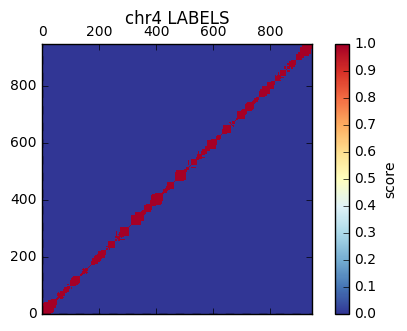

1.0
(947, 947)
Limit: 1.0


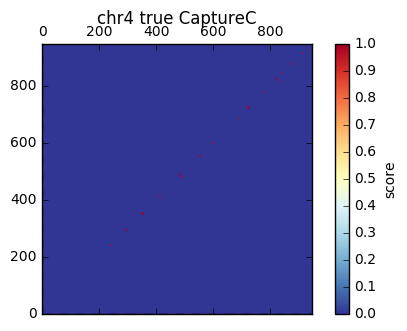

30.7571129985
(947, 947)
Limit: 30.7571129985


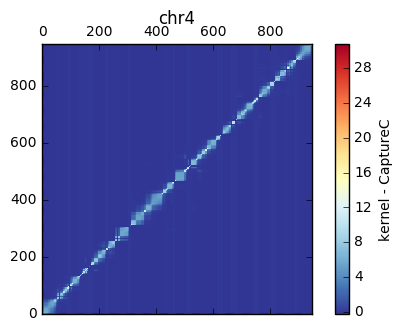

chr5
Balanced Accuracy: 61.88%	auROC: 0.716	 auPRC: 0.682
Recall at 5% | 10% | 25% FDR: 3.2% | 3.8% | 11.8%	Num Positives: 38254	 Num Negatives: 38254

chr5
0.999999998942
(1117, 1117)
Limit: 0.999999998942


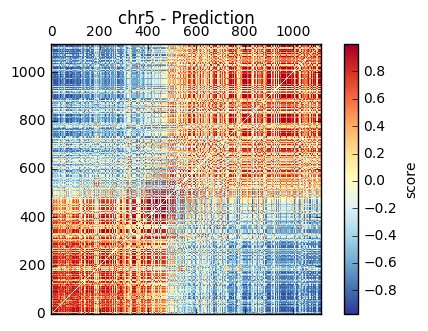

1.0
(1117, 1117)
Limit: 1.0


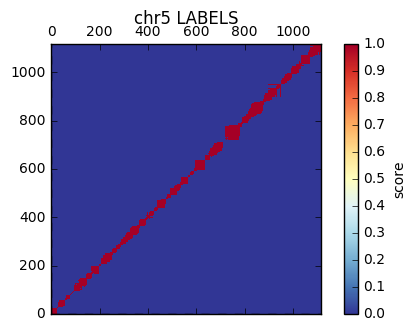

1.0
(1117, 1117)
Limit: 1.0


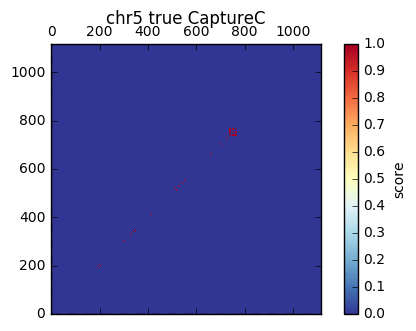

33.406586177
(1117, 1117)
Limit: 33.406586177


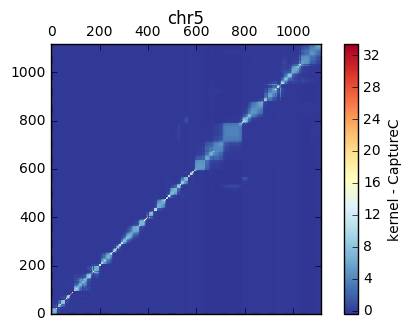

chr6
Balanced Accuracy: 62.84%	auROC: 0.726	 auPRC: 0.697
Recall at 5% | 10% | 25% FDR: 4.0% | 4.8% | 18.0%	Num Positives: 28838	 Num Negatives: 28838

chr6
0.999999999971
(1224, 1224)
Limit: 0.999999999971


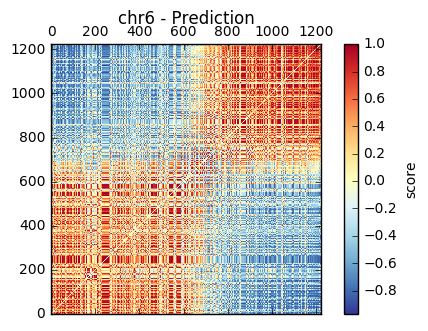

1.0
(1224, 1224)
Limit: 1.0


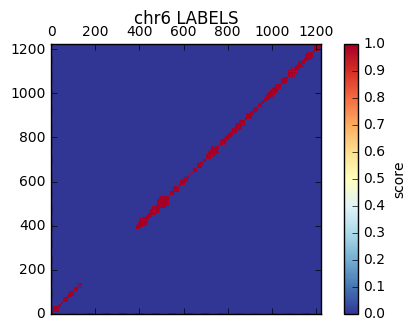

1.0
(1224, 1224)
Limit: 1.0


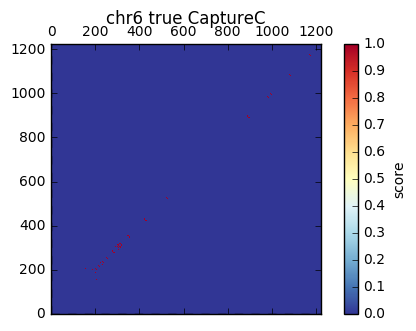

34.9714169001
(1224, 1224)
Limit: 34.9714169001


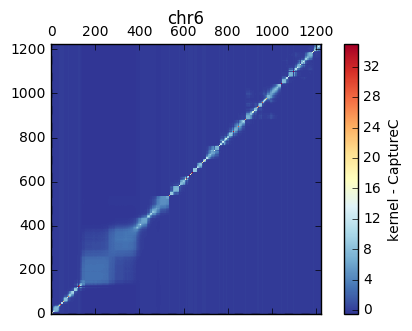

chr7
Balanced Accuracy: 60.78%	auROC: 0.697	 auPRC: 0.674
Recall at 5% | 10% | 25% FDR: 4.3% | 4.8% | 10.4%	Num Positives: 33154	 Num Negatives: 33154

chr7
0.999999999772
(1020, 1020)
Limit: 0.999999999772


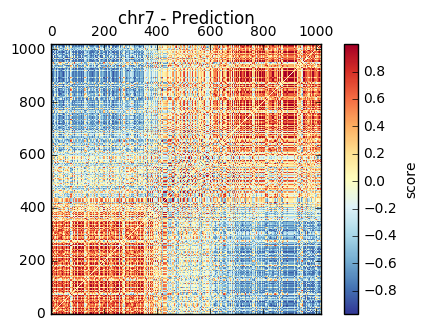

1.0
(1020, 1020)
Limit: 1.0


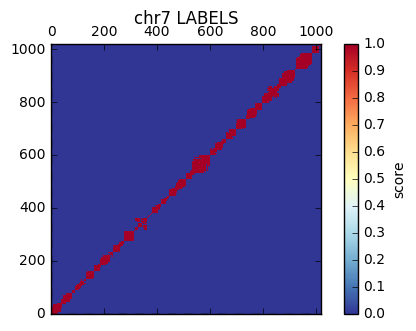

1.0
(1020, 1020)
Limit: 1.0


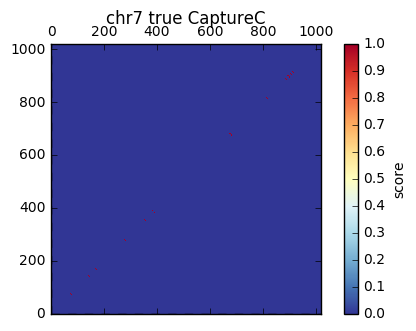

31.921779399
(1020, 1020)
Limit: 31.921779399


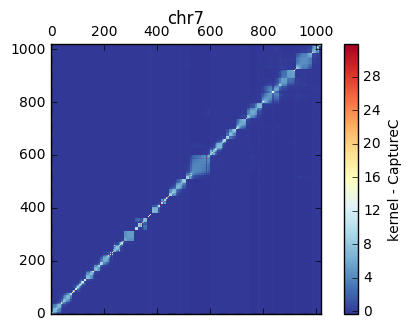

chr8
Balanced Accuracy: 58.55%	auROC: 0.676	 auPRC: 0.652
Recall at 5% | 10% | 25% FDR: 4.0% | 4.5% | 6.6%	Num Positives: 27913	 Num Negatives: 27913

chr8
0.999999999858
(897, 897)
Limit: 0.999999999858


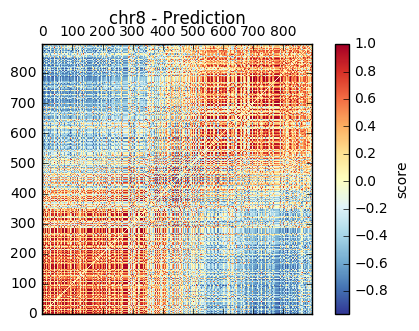

1.0
(897, 897)
Limit: 1.0


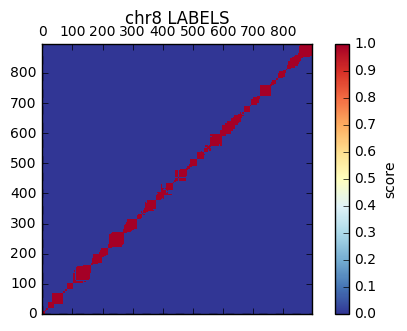

1.0
(897, 897)
Limit: 1.0


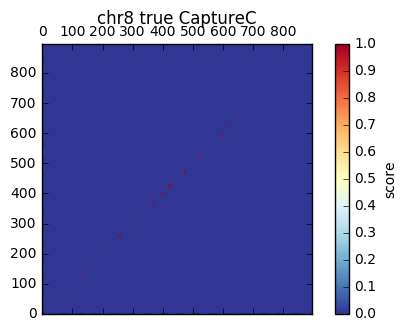

29.9332590942
(897, 897)
Limit: 29.9332590942


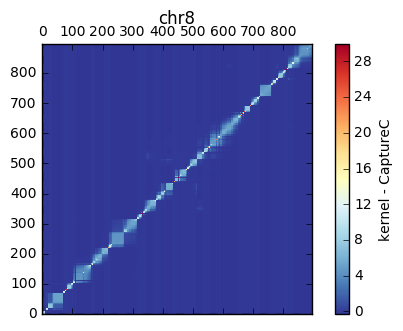

chr9
Balanced Accuracy: 58.84%	auROC: 0.686	 auPRC: 0.658
Recall at 5% | 10% | 25% FDR: 2.2% | 2.5% | 6.7%	Num Positives: 30009	 Num Negatives: 30009

chr9
0.999999998112
(859, 859)
Limit: 0.999999998112


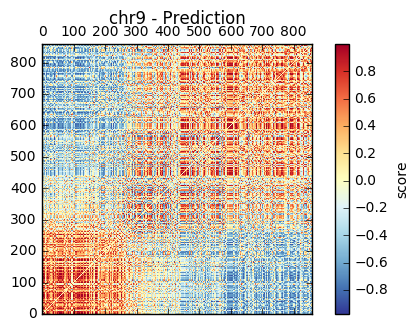

1.0
(859, 859)
Limit: 1.0


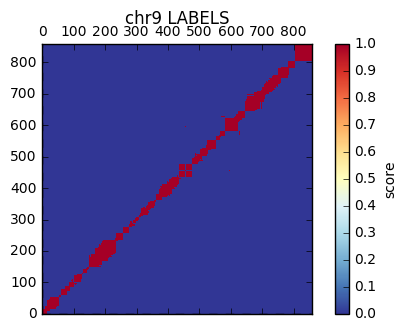

1.0
(859, 859)
Limit: 1.0


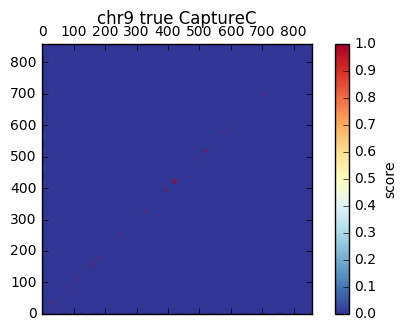

29.2916370318
(859, 859)
Limit: 29.2916370318


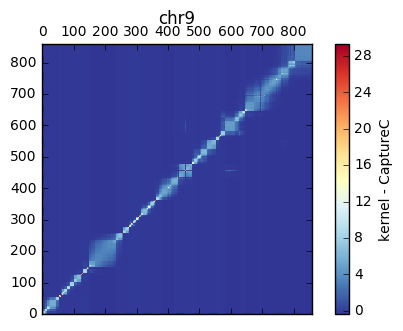

chr10
Balanced Accuracy: 58.22%	auROC: 0.663	 auPRC: 0.652
Recall at 5% | 10% | 25% FDR: 3.7% | 4.2% | 9.9%	Num Positives: 30260	 Num Negatives: 30260

chr10
0.999999999951
(943, 943)
Limit: 0.999999999951


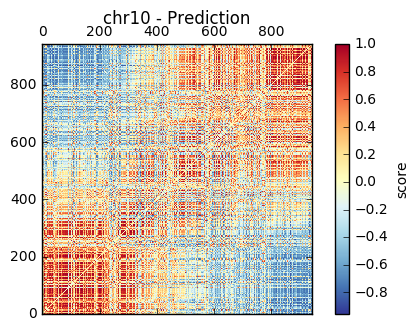

1.0
(943, 943)
Limit: 1.0


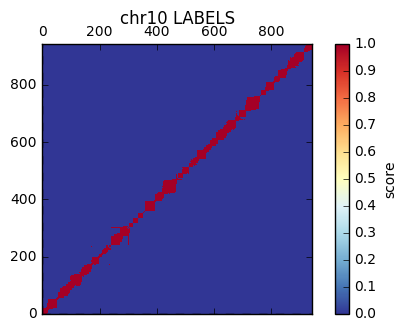

1.0
(943, 943)
Limit: 1.0


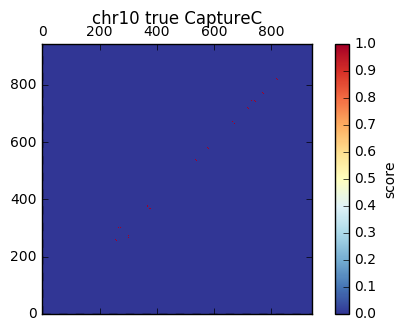

30.6920185064
(943, 943)
Limit: 30.6920185064


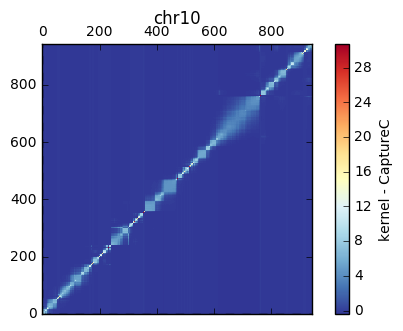

chr11
Balanced Accuracy: 61.88%	auROC: 0.707	 auPRC: 0.694
Recall at 5% | 10% | 25% FDR: 0.1% | 7.0% | 24.1%	Num Positives: 37648	 Num Negatives: 37648

chr11
0.999999999706
(1401, 1401)
Limit: 0.999999999706


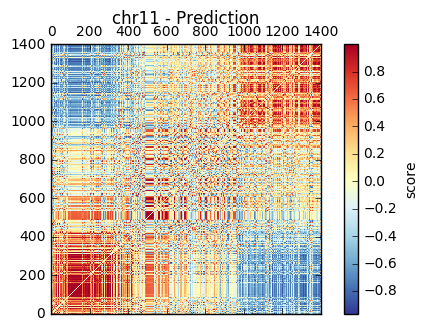

1.0
(1401, 1401)
Limit: 1.0


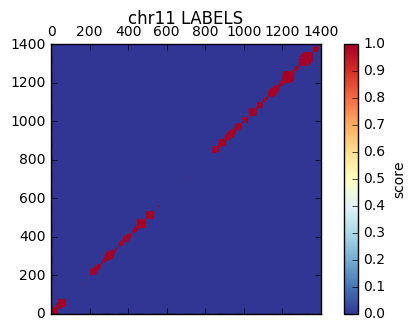

1.0
(1401, 1401)
Limit: 1.0


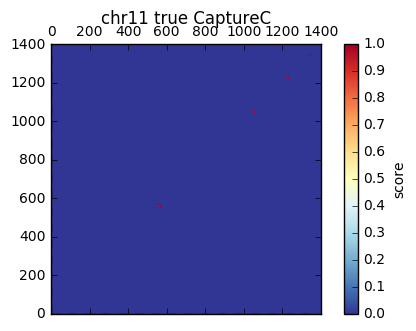

37.4165738677
(1401, 1401)
Limit: 37.4165738677


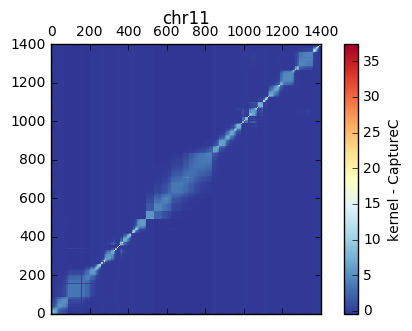

chr12
Balanced Accuracy: 60.02%	auROC: 0.700	 auPRC: 0.685
Recall at 5% | 10% | 25% FDR: 5.0% | 5.8% | 18.2%	Num Positives: 34876	 Num Negatives: 34876

chr12
0.999999999986
(1200, 1200)
Limit: 0.999999999986


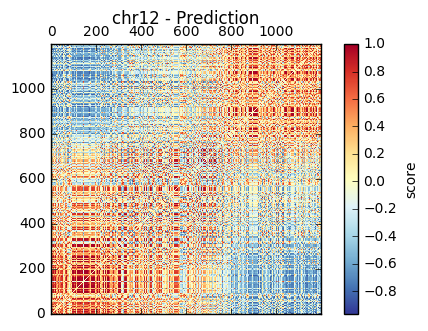

1.0
(1200, 1200)
Limit: 1.0


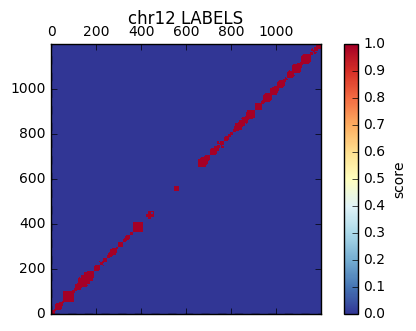

1.0
(1200, 1200)
Limit: 1.0


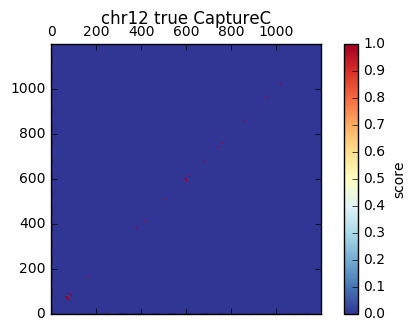

34.6265793864
(1200, 1200)
Limit: 34.6265793864


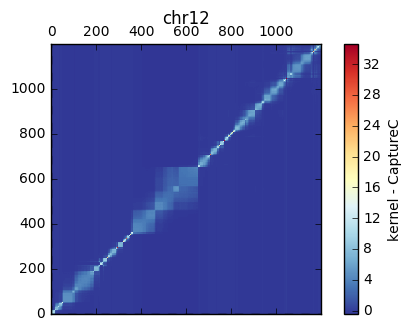

chr13
Balanced Accuracy: 56.24%	auROC: 0.640	 auPRC: 0.631
Recall at 5% | 10% | 25% FDR: 4.7% | 5.1% | 9.3%	Num Positives: 12022	 Num Negatives: 12022

chr13
0.999999976902
(452, 452)
Limit: 0.999999976902


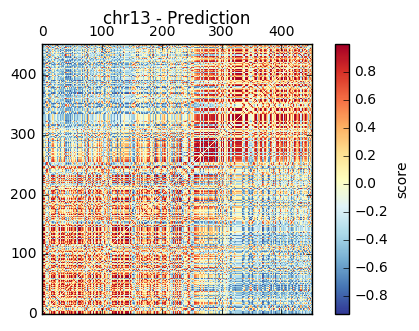

1.0
(452, 452)
Limit: 1.0


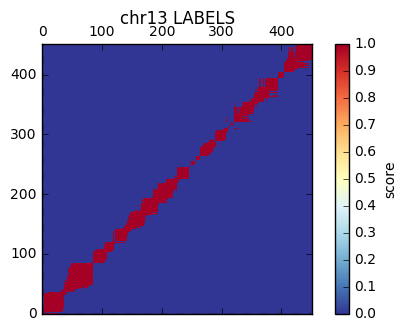

1.0
(452, 452)
Limit: 1.0


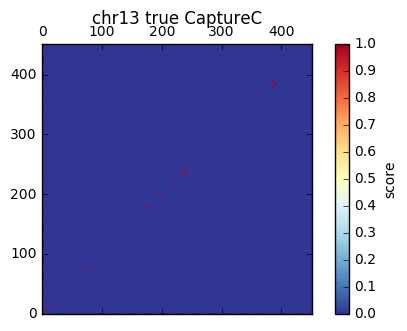

21.2367605816
(452, 452)
Limit: 21.2367605816


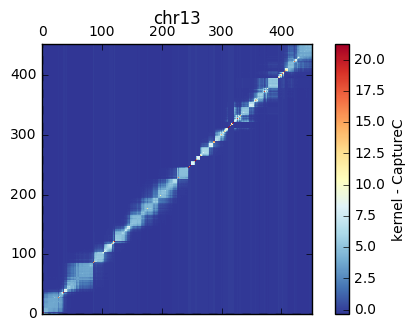

chr14
Balanced Accuracy: 58.60%	auROC: 0.664	 auPRC: 0.660
Recall at 5% | 10% | 25% FDR: 3.9% | 4.8% | 15.4%	Num Positives: 29725	 Num Negatives: 29725

chr14
0.999999999861
(779, 779)
Limit: 0.999999999861


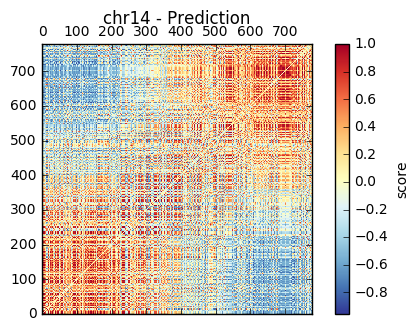

1.0
(779, 779)
Limit: 1.0


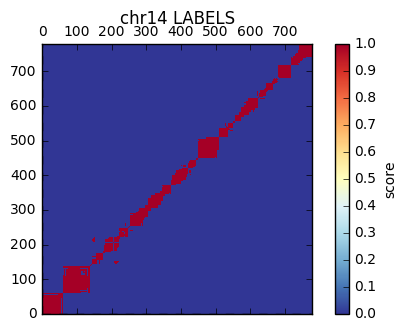

1.0
(779, 779)
Limit: 1.0


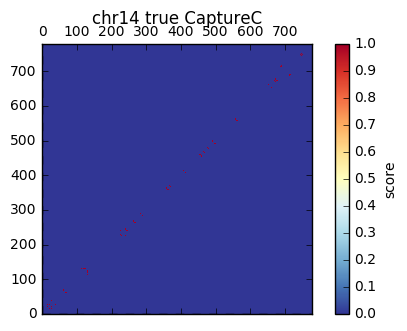

27.892651362
(779, 779)
Limit: 27.892651362


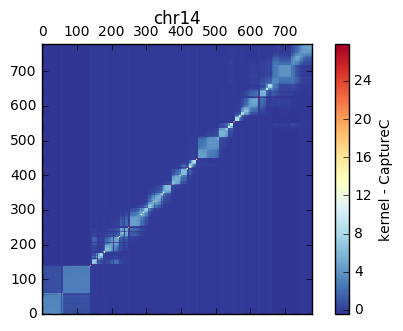

chr15
Balanced Accuracy: 56.16%	auROC: 0.616	 auPRC: 0.631
Recall at 5% | 10% | 25% FDR: 5.0% | 7.2% | 13.0%	Num Positives: 21763	 Num Negatives: 21763

chr15
0.99999999836
(629, 629)
Limit: 0.99999999836


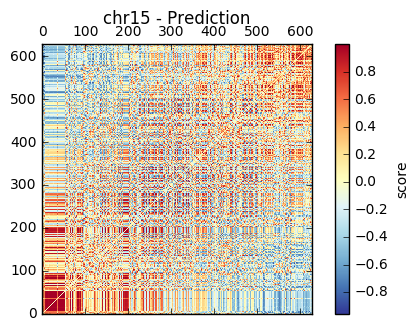

1.0
(629, 629)
Limit: 1.0


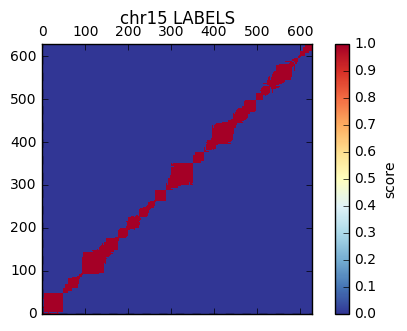

1.0
(629, 629)
Limit: 1.0


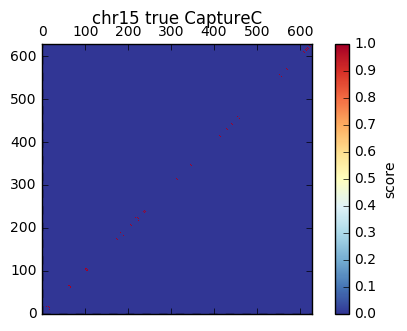

25.0599281723
(629, 629)
Limit: 25.0599281723


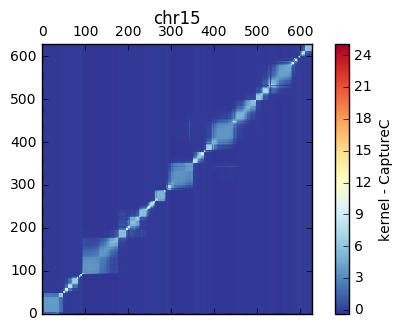

chr16
Balanced Accuracy: 55.91%	auROC: 0.643	 auPRC: 0.622
Recall at 5% | 10% | 25% FDR: 1.0% | 1.1% | 4.1%	Num Positives: 29664	 Num Negatives: 29664

chr16
0.999999997732
(726, 726)
Limit: 0.999999997732


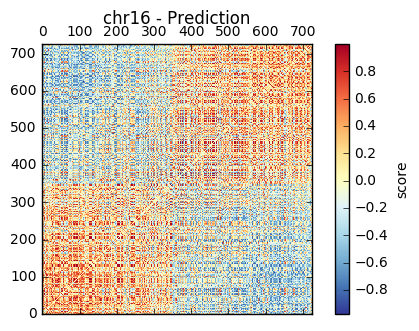

1.0
(726, 726)
Limit: 1.0


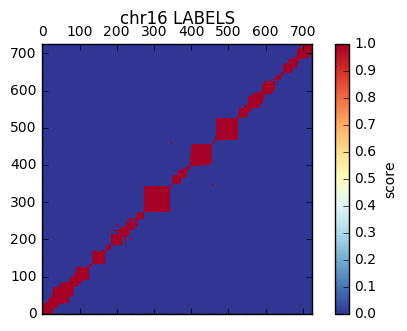

1.0
(726, 726)
Limit: 1.0


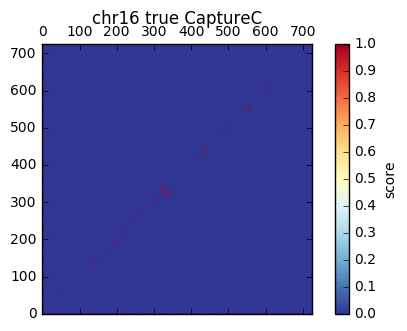

26.9258240357
(726, 726)
Limit: 26.9258240357


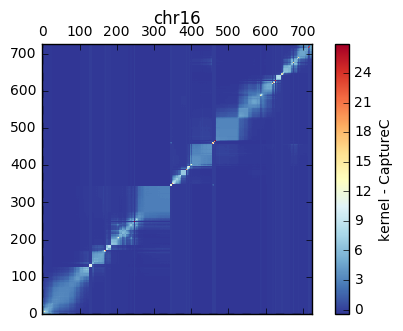

chr17
Balanced Accuracy: 54.36%	auROC: 0.590	 auPRC: 0.590
Recall at 5% | 10% | 25% FDR: 1.1% | 1.4% | 5.0%	Num Positives: 37422	 Num Negatives: 37422

chr17
0.999999998917
(1057, 1057)
Limit: 0.999999998917


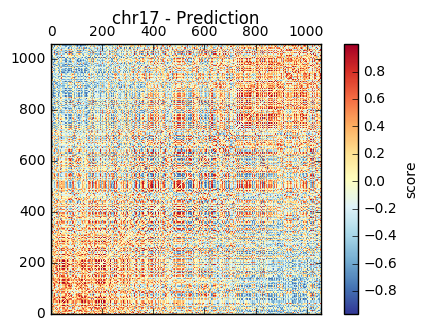

1.0
(1057, 1057)
Limit: 1.0


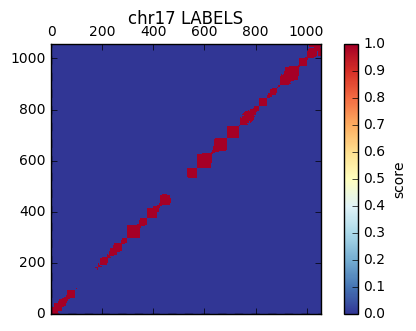

1.0
(1057, 1057)
Limit: 1.0


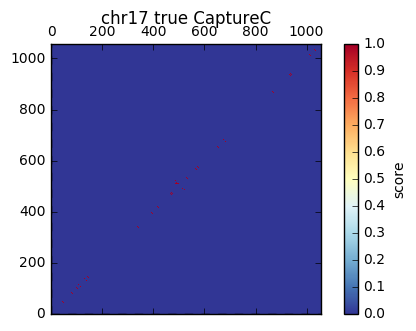

32.4961536185
(1057, 1057)
Limit: 32.4961536185


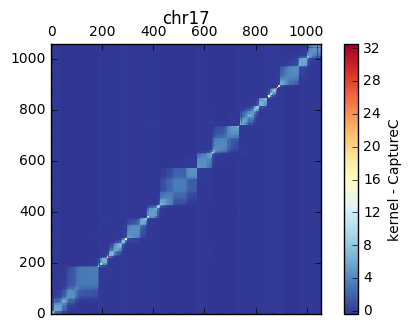

chr18
Balanced Accuracy: 58.21%	auROC: 0.683	 auPRC: 0.659
Recall at 5% | 10% | 25% FDR: 3.5% | 4.8% | 11.3%	Num Positives: 7860	 Num Negatives: 7860

chr18
0.999999973164
(352, 352)
Limit: 0.999999973164


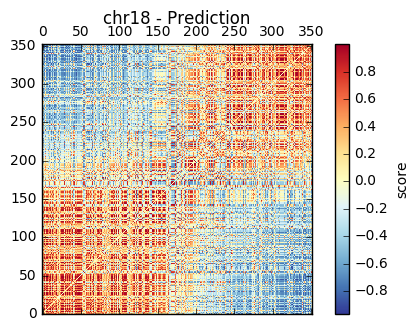

1.0
(352, 352)
Limit: 1.0


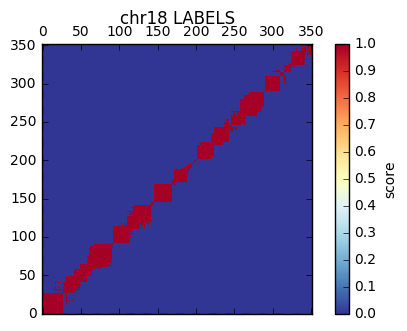

1.0
(352, 352)
Limit: 1.0


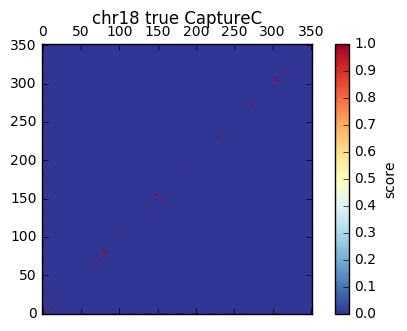

18.7349939952
(352, 352)
Limit: 18.7349939952


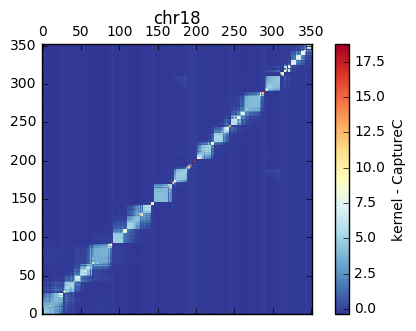

chr19
Balanced Accuracy: 54.28%	auROC: 0.580	 auPRC: 0.578
Recall at 5% | 10% | 25% FDR: 0.4% | 0.6% | 2.1%	Num Positives: 29959	 Num Negatives: 29959

chr19
0.999999971635
(1052, 1052)
Limit: 0.999999971635


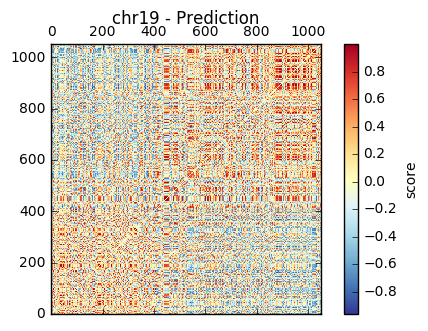

1.0
(1052, 1052)
Limit: 1.0


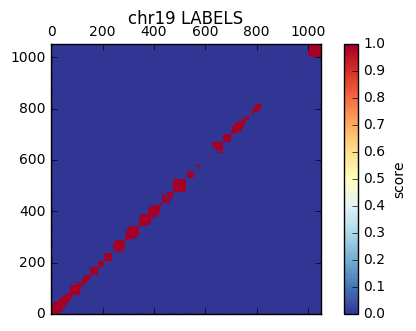

1.0
(1052, 1052)
Limit: 1.0


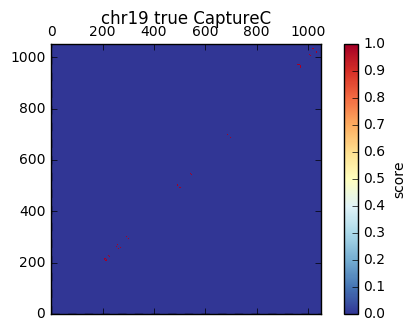

32.4191301549
(1052, 1052)
Limit: 32.4191301549


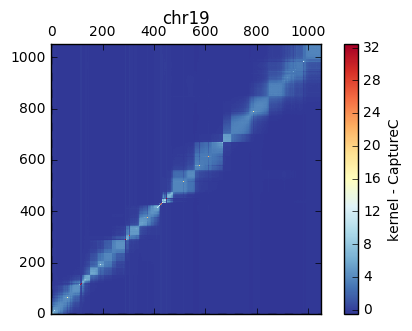

chr20
Balanced Accuracy: 54.15%	auROC: 0.593	 auPRC: 0.591
Recall at 5% | 10% | 25% FDR: 1.6% | 1.8% | 5.5%	Num Positives: 24143	 Num Negatives: 24143

chr20
0.999999996992
(619, 619)
Limit: 0.999999996992


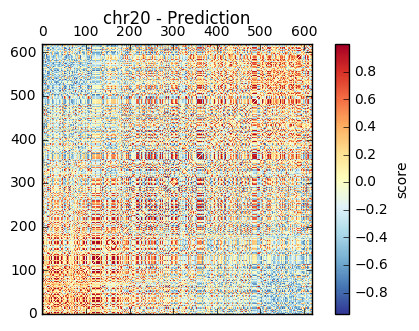

1.0
(619, 619)
Limit: 1.0


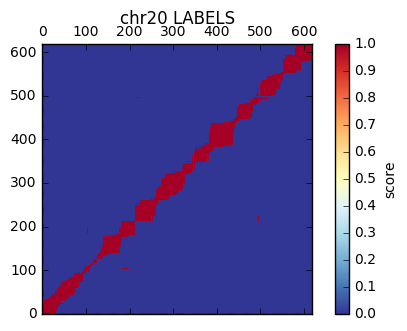

1.0
(619, 619)
Limit: 1.0


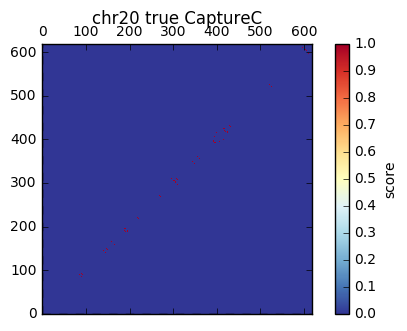

24.4210869748
(619, 619)
Limit: 24.4210869748


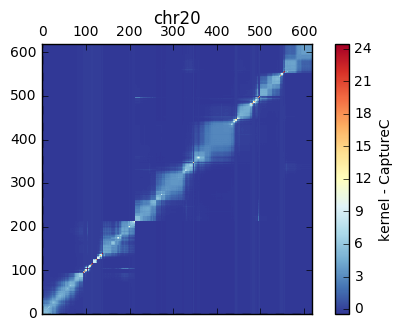

chr21
Balanced Accuracy: 51.12%	auROC: 0.524	 auPRC: 0.555
Recall at 5% | 10% | 25% FDR: 7.6% | 7.6% | 7.9%	Num Positives: 9004	 Num Negatives: 9004

chr21
0.999999998598
(280, 280)
Limit: 0.999999998598


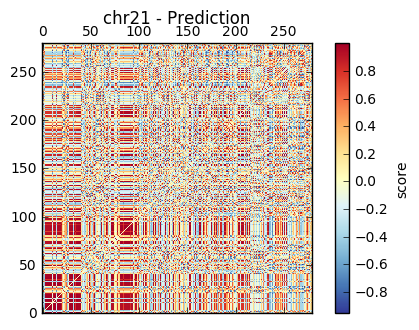

1.0
(280, 280)
Limit: 1.0


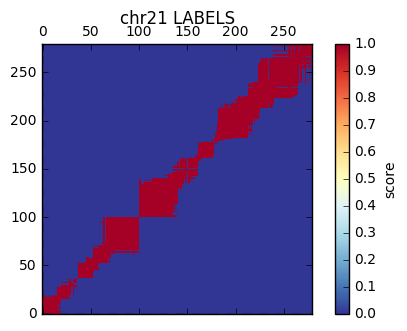

1.0
(280, 280)
Limit: 1.0


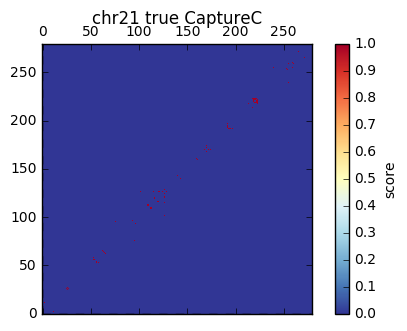

16.7032930885
(280, 280)
Limit: 16.7032930885


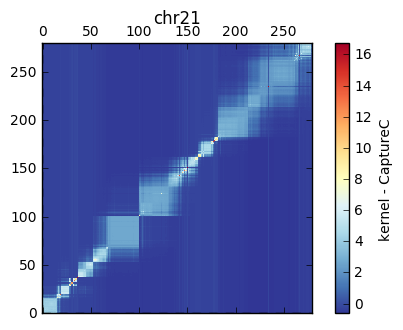

chr22
Balanced Accuracy: 49.89%	auROC: 0.503	 auPRC: 0.509
Recall at 5% | 10% | 25% FDR: 0.7% | 0.7% | 0.8%	Num Positives: 17145	 Num Negatives: 17145

chr22
0.999999641878
(431, 431)
Limit: 0.999999641878


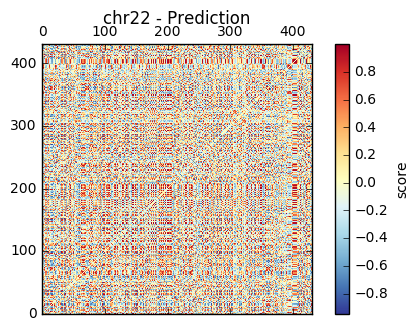

1.0
(431, 431)
Limit: 1.0


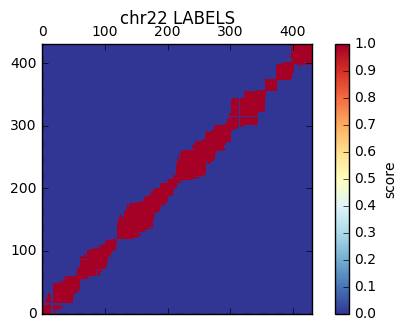

1.0
(431, 431)
Limit: 1.0


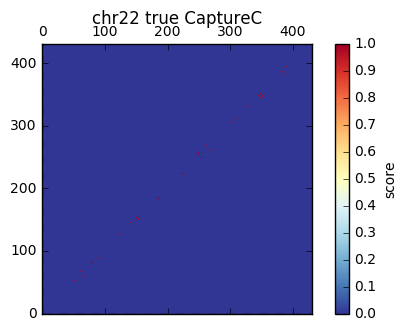

20.7364413533
(431, 431)
Limit: 20.7364413533


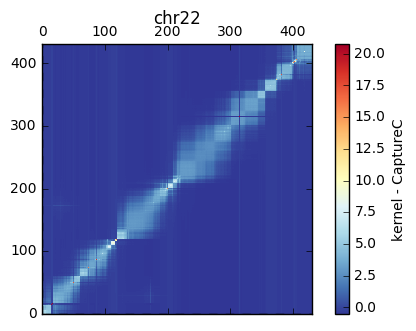

chrX
Balanced Accuracy: 63.18%	auROC: 0.720	 auPRC: 0.689
Recall at 5% | 10% | 25% FDR: 8.1% | 9.0% | 11.4%	Num Positives: 25318	 Num Negatives: 25318

chrX
0.999999999965
(861, 861)
Limit: 0.999999999965


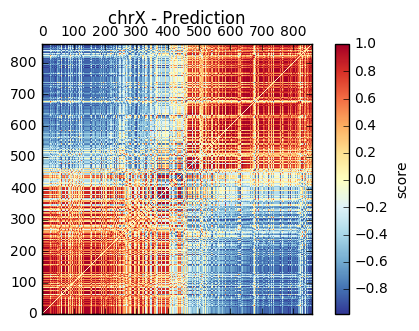

1.0
(861, 861)
Limit: 1.0


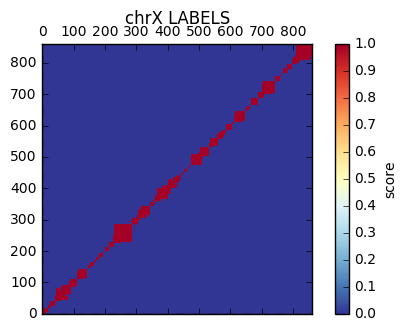

1.0
(861, 861)
Limit: 1.0


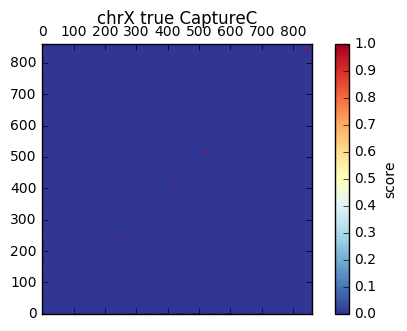

29.3257565972
(861, 861)
Limit: 29.3257565972


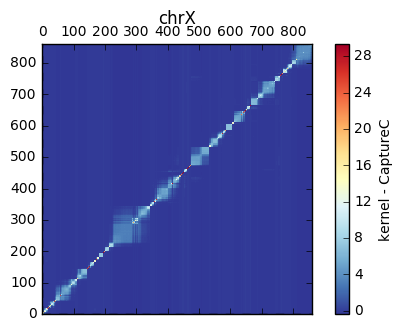

chr1 ROC= 0.756443700034 PRC= 0.717414447852
chr2 ROC= 0.759487319565 PRC= 0.708668532063
chr3 ROC= 0.726396410193 PRC= 0.684728028586
chr4 ROC= 0.725946206353 PRC= 0.705755699291
chr5 ROC= 0.715856368745 PRC= 0.68235533368
chr6 ROC= 0.725921701809 PRC= 0.696866529133
chr7 ROC= 0.696714742034 PRC= 0.673524677368
chr8 ROC= 0.67626321139 PRC= 0.652274423077
chr9 ROC= 0.686105104077 PRC= 0.657652547017
chr10 ROC= 0.663418884757 PRC= 0.651644719573
chr11 ROC= 0.706845803259 PRC= 0.694471852002
chr12 ROC= 0.699720735574 PRC= 0.684874739479
chr13 ROC= 0.639781470343 PRC= 0.631099635346
chr14 ROC= 0.66352906125 PRC= 0.659828942372
chr15 ROC= 0.616449143252 PRC= 0.630773748218
chr16 ROC= 0.643379006505 PRC= 0.622046301507
chr17 ROC= 0.589617449848 PRC= 0.589633277759
chr18 ROC= 0.682569521331 PRC= 0.659097752623
chr19 ROC= 0.580072647902 PRC= 0.578363030285
chr20 ROC= 0.593042301254 PRC= 0.591018908459
chr21 ROC= 0.523884468347 PRC= 0.554938824747
chr22 ROC= 0.502729674101 PRC= 0.50931681333
c

In [11]:
performance_on_pos_and_neg_subsmpl(0.01)

### Evaluation on pos + distance-matched neg [10kb, 2Mb]

## thres=0.05

In [18]:
all_chrs = ['chr'+str(i+1) for i in range(22)]+['chrX']
ROC=[]
PRC=[]
for chr in all_chrs:
    y=np.load(DATADIR_dist_matched_labels+'labels_dist_matched_kernel_'+chr+'_thres05.npy')
    y_pred=np.load(DATADIR_dist_matched_preds+'preds_dist_matched_kernel_'+chr+'_thres05.npy')
    ROC.append(roc_auc_score(y, y_pred))
    precision, recall = precision_recall_curve(y, y_pred)[:2]
    PRC.append(auc(recall, precision))
    print(ClassificationResult(y, y_pred))
    
for i in enumerate(all_chrs):     
    print i[1], "ROC=", ROC[i[0]], "PRC=", PRC[i[0]]
print "Average across all chrs: ROC=", sum(ROC)/len(ROC), " PRC=", sum(PRC)/len(PRC)

Balanced Accuracy: 52.58%	auROC: 0.589	 auPRC: 0.673
Recall at 5% | 10% | 25% FDR: 20.6% | 22.4% | 29.8%	Num Positives: 892	 Num Negatives: 892

Balanced Accuracy: 36.79%	auROC: 0.382	 auPRC: 0.494
Recall at 5% | 10% | 25% FDR: 0.0% | 0.0% | 13.3%	Num Positives: 2588	 Num Negatives: 2588

Balanced Accuracy: 49.58%	auROC: 0.499	 auPRC: 0.572
Recall at 5% | 10% | 25% FDR: 0.2% | 0.2% | 20.4%	Num Positives: 1656	 Num Negatives: 1656

Balanced Accuracy: 39.84%	auROC: 0.399	 auPRC: 0.505
Recall at 5% | 10% | 25% FDR: 0.2% | 0.2% | 8.6%	Num Positives: 1600	 Num Negatives: 1600

Balanced Accuracy: 39.03%	auROC: 0.384	 auPRC: 0.479
Recall at 5% | 10% | 25% FDR: 0.2% | 0.2% | 0.2%	Num Positives: 1212	 Num Negatives: 1212

Balanced Accuracy: 49.20%	auROC: 0.484	 auPRC: 0.530
Recall at 5% | 10% | 25% FDR: 0.1% | 0.1% | 1.3%	Num Positives: 2120	 Num Negatives: 2120

Balanced Accuracy: 46.34%	auROC: 0.474	 auPRC: 0.568
Recall at 5% | 10% | 25% FDR: 0.3% | 12.0% | 17.1%	Num Positives: 2062	 Num Nega

## Thres=0.03

In [19]:
all_chrs = ['chr'+str(i+1) for i in range(22)]+['chrX']
ROC=[]
PRC=[]
for chr in all_chrs:
    y=np.load(DATADIR_dist_matched_labels+'labels_dist_matched_kernel_'+chr+'_thres05.npy')
    y_pred=np.load(DATADIR_dist_matched_preds+'preds_dist_matched_kernel_'+chr+'_thres05.npy')
    ROC.append(roc_auc_score(y, y_pred))
    precision, recall = precision_recall_curve(y, y_pred)[:2]
    PRC.append(auc(recall, precision))
    print(ClassificationResult(y, y_pred))
    
for i in enumerate(all_chrs):     
    print i[1], "ROC=", ROC[i[0]], "PRC=", PRC[i[0]]
print "Average across all chrs: ROC=", sum(ROC)/len(ROC), " PRC=", sum(PRC)/len(PRC)

Balanced Accuracy: 52.58%	auROC: 0.589	 auPRC: 0.673
Recall at 5% | 10% | 25% FDR: 20.6% | 22.4% | 29.8%	Num Positives: 892	 Num Negatives: 892

Balanced Accuracy: 36.79%	auROC: 0.382	 auPRC: 0.494
Recall at 5% | 10% | 25% FDR: 0.0% | 0.0% | 13.3%	Num Positives: 2588	 Num Negatives: 2588

Balanced Accuracy: 49.58%	auROC: 0.499	 auPRC: 0.572
Recall at 5% | 10% | 25% FDR: 0.2% | 0.2% | 20.4%	Num Positives: 1656	 Num Negatives: 1656

Balanced Accuracy: 39.84%	auROC: 0.399	 auPRC: 0.505
Recall at 5% | 10% | 25% FDR: 0.2% | 0.2% | 8.6%	Num Positives: 1600	 Num Negatives: 1600

Balanced Accuracy: 39.03%	auROC: 0.384	 auPRC: 0.479
Recall at 5% | 10% | 25% FDR: 0.2% | 0.2% | 0.2%	Num Positives: 1212	 Num Negatives: 1212

Balanced Accuracy: 49.20%	auROC: 0.484	 auPRC: 0.530
Recall at 5% | 10% | 25% FDR: 0.1% | 0.1% | 1.3%	Num Positives: 2120	 Num Negatives: 2120

Balanced Accuracy: 46.34%	auROC: 0.474	 auPRC: 0.568
Recall at 5% | 10% | 25% FDR: 0.3% | 12.0% | 17.1%	Num Positives: 2062	 Num Nega

# Thres=0.01

In [21]:
all_chrs = ['chr'+str(i+1) for i in range(22)]+['chrX']
ROC=[]
PRC=[]
for chr in all_chrs:
    y=np.load(DATADIR_dist_matched_labels+'labels_dist_matched_kernel_'+chr+'_thres01.npy')
    y_pred=np.load(DATADIR_dist_matched_preds+'preds_dist_matched_kernel_'+chr+'_thres01.npy')
    ROC.append(roc_auc_score(y, y_pred))
    precision, recall = precision_recall_curve(y, y_pred)[:2]
    PRC.append(auc(recall, precision))
    print(ClassificationResult(y, y_pred))
    
for i in enumerate(all_chrs):     
    print i[1], "ROC=", ROC[i[0]], "PRC=", PRC[i[0]]
print "Average across all chrs: ROC=", sum(ROC)/len(ROC), " PRC=", sum(PRC)/len(PRC)

Balanced Accuracy: 57.38%	auROC: 0.593	 auPRC: 0.567
Recall at 5% | 10% | 25% FDR: 0.0% | 0.0% | 0.0%	Num Positives: 38648	 Num Negatives: 38648

Balanced Accuracy: 52.27%	auROC: 0.526	 auPRC: 0.512
Recall at 5% | 10% | 25% FDR: 0.1% | 0.1% | 0.4%	Num Positives: 6426	 Num Negatives: 6426

Balanced Accuracy: 51.53%	auROC: 0.522	 auPRC: 0.529
Recall at 5% | 10% | 25% FDR: 0.0% | 0.0% | 0.0%	Num Positives: 9118	 Num Negatives: 9118

Balanced Accuracy: 50.12%	auROC: 0.498	 auPRC: 0.482
Recall at 5% | 10% | 25% FDR: 0.0% | 0.0% | 0.0%	Num Positives: 2406	 Num Negatives: 2406

Balanced Accuracy: 56.83%	auROC: 0.594	 auPRC: 0.590
Recall at 5% | 10% | 25% FDR: 0.1% | 0.1% | 1.6%	Num Positives: 7346	 Num Negatives: 7346

Balanced Accuracy: 52.24%	auROC: 0.517	 auPRC: 0.533
Recall at 5% | 10% | 25% FDR: 0.0% | 0.0% | 0.0%	Num Positives: 21940	 Num Negatives: 21940

Balanced Accuracy: 53.09%	auROC: 0.542	 auPRC: 0.526
Recall at 5% | 10% | 25% FDR: 0.0% | 0.0% | 0.0%	Num Positives: 5088	 Num Negat